# Package installation and SVHN Dataset downloading



In [ ]:
%pip install scipy
%pip install torch
%pip install torchvision
%pip install scipy
%pip install numpy
%pip install pytorch_lightning
%pip install torchmetrics
%pip install matplotlib
%pip install IProgress
%pip install ipywidgets
# %pip install opencv-python

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import torchvision

torchvision.datasets.SVHN('./data','train',download=True)
torchvision.datasets.SVHN('./data','test',download=True)

  0%|          | 0/182040794 [00:00<?, ?it/s]

  0%|          | 0/64275384 [00:00<?, ?it/s]

Dataset SVHN
    Number of datapoints: 26032
    Root location: ./data
    Split: test

In [ ]:
import os 
import scipy.io as sio
import numpy as np
import matplotlib.pyplot as plt
import torch
from torch.utils.data import Dataset, DataLoader, ConcatDataset
import torchvision.transforms.functional as F
import torchvision.transforms as transforms
from PIL import Image
import torch.nn as nn
import torchmetrics
import pytorch_lightning as pl
from pytorch_lightning import loggers as pl_loggers
from torchvision.datasets import SVHN
from sklearn.neighbors import NearestNeighbors
from tqdm import tqdm

In [ ]:
!nvidia-smi

Thu Jun  2 07:18:50 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   50C    P8     9W /  70W |      0MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

# 1. SVHN Dataset

1. The SVHN dataset contains 32x32 pixels color images depicting digits from 0 to 9.
2. The original training and testing splits contain ~73K and ~26K images, respectively. The digit labels for each split and image are also provided
3. Two files containing the images and labels from both splits are saved in the "./data" folder as numpy arrays.



## 1.1 Loading a specific split for a given task



In [ ]:
def load_data(root_dir, split):
    
    filename = os.path.join(root_dir,'test_32x32.mat')
    if(split.startswith('train') or split.startswith('unlabelled')):
        filename = os.path.join(root_dir,'train_32x32.mat') 
    elif(split.startswith('test')):
        filename = os.path.join(root_dir,'test_32x32.mat')
    
    loaded_mat = sio.loadmat(filename)
    imgs = (loaded_mat['X']/255).astype(np.float32)
    labels = loaded_mat['y'].astype(np.int64).squeeze()
    if(split=='train_29_task2'):
        imgs_idx_01 =  np.logical_or(labels==10,labels==1)
        imgs_idx_29 = np.where(np.logical_not(imgs_idx_01))
        imgs = imgs[:,:,:,imgs_idx_29]
        imgs = np.squeeze(imgs, axis=3)
        labels = labels[imgs_idx_29]
    elif(split=='test_01_task2' or split=='train_01_task2'):
        imgs_idx_01 =  np.where(np.logical_or(labels==10,labels==1))[0]
        if(split=='train_01_task2'):
            imgs_idx_01 = imgs_idx_01[0:200]
        else:
            imgs_idx_01 = imgs_idx_01[200::]
        imgs = imgs[:,:,:,imgs_idx_01]
        labels = labels[imgs_idx_01]
    if(split=='test_task3'):
        N = 50
        imgs = imgs[:,:,:,0:N]
        labels = labels[0:N]
    print('Loaded SVHN split: {split}'.format(split=split))
    print('-------------------------------------')
    print('Images Size: ' , imgs.shape[0:-1])
    print('Split Number of Images:', imgs.shape[-1])
    print('Split Labels Array Size:', labels.shape)
    print('Possible Labels: ', np.unique(labels))
    return imgs,labels

# split_images, split_labels = load_data('./data','train_29_task2')
# split_images, split_labels = load_data('./data','test_01_task2')
# split_images, split_labels = load_data('./data','train_01_task2')

split_images, split_labels = load_data('./data','train_task1')


Loaded SVHN split: train_task1
-------------------------------------
Images Size:  (32, 32, 3)
Split Number of Images: 73257
Split Labels Array Size: (73257,)
Possible Labels:  [ 1  2  3  4  5  6  7  8  9 10]


## 1.2 VIsualizing images and their labels

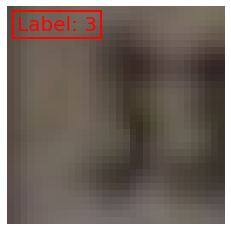

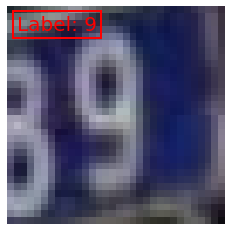

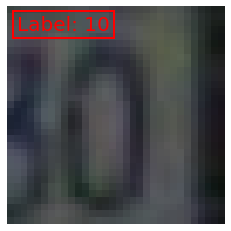

In [ ]:
# Example: Visualize images and its labels
def visualize_image(images, labels, index):
    img = images[:,:,:,index]
    label = labels[index]
    plt.imshow((img))
    plt.text(1, 3, 'Label: {label}'.format(label=label), c = 'red', fontsize= 20,
             bbox=dict(fill=False, edgecolor='red', linewidth=2))
    plt.axis('off')
    plt.show()
    
image_index = 10
visualize_image(split_images,
                split_labels,
                image_index)

image_index = 50
visualize_image(split_images,
                split_labels,
                image_index)

image_index = 2000
visualize_image(split_images,
                split_labels,
                image_index)

<font color='red'>COMMENTS</font> 

After exploring the dataset, I thought to clean the images before feeding the model. For that, I created a function that:
* Convert the image to grayscale, to have only one channel reducing the number of params needed in NN, and that has practically the same information as the RGB image.
* Apply Otsu thresholding to binarize the image, and segment the numbers from the background.
* Identify the center number and remove the numbers that could be at the sides.

After visualizing the results of this algorithm on a random sample of the data, I've decided not to use it because for some images works really well, but for other images, which are typically blurred and more difficult to identify the number, the algorithm removes a lot of information that could be useful for the NN.



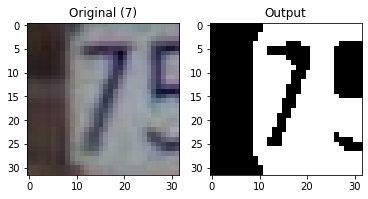

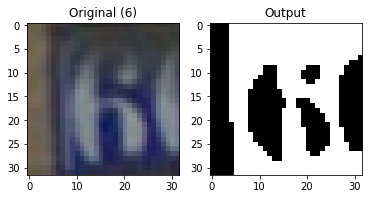

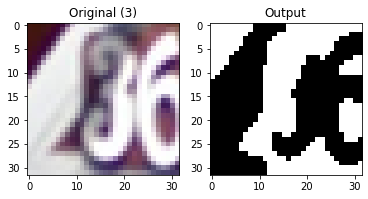

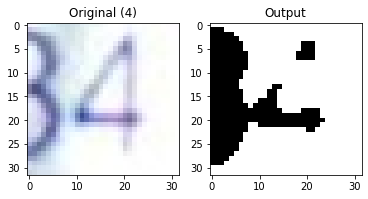

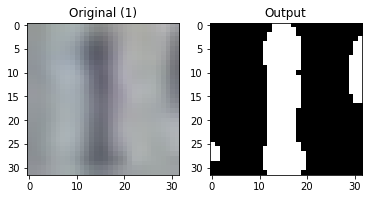

...

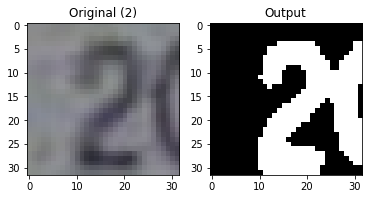

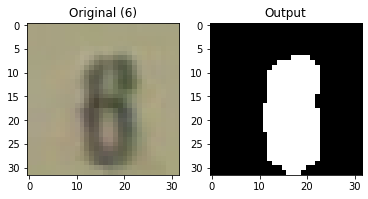

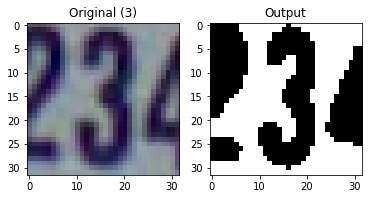

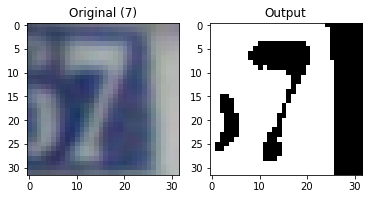

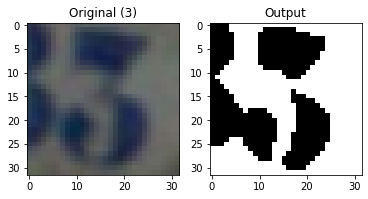

In [ ]:
import random
import cv2
from collections import Counter

def image_preprocessing(img, label, plot=False):
    '''
    Preprocess the image and convert it to a binary image to remove noise

    Args:
    - img (np.array): Source image
    - label (int): Label of the source image
    - plot (bool): If the results are plotted

    Return:
    - np.array with the binarized result image
    '''
    img = img * 255
    img = img.astype('uint8')

    # Convert image to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

    # Gaussian filter to smooth the image before the thresholding 
    blur = cv2.GaussianBlur(gray, (5, 5), 0)
    # Compute Otsu thresholding to binarize the image
    ret3, th3 = cv2.threshold(blur, 0, 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)

    # Count the objects (connected pixels) in the image
    ret, labels = cv2.connectedComponents(th3)

    # Get the id of the object on the center of the image (the object that has more pixels in the center)
    centered_objects = Counter(labels[11:21, 11:21].flatten())
    center_object_idx = max(centered_objects, key=centered_objects.get)

    # Remove rest of the objects
    labels_clean = labels.copy()
    labels_clean = labels_clean + 1
    labels_clean[labels_clean != (center_object_idx + 1)] = 0
    labels_clean[labels_clean == (center_object_idx + 1)] = 1

    # Plot the results
    if plot:
        plt.subplot(1, 2, 1)
        plt.imshow(img)
        plt.title(f'Original ({label})')

        plt.subplot(1, 2, 2)
        plt.imshow(labels_clean, cmap='gray')
        plt.title('Output')
        plt.show()

    return labels_clean

split_images, split_labels = load_data('./data','train_task1')

# Plot 100 samples from the dataset to check the result
for i in [random.randint(0, 70000) for _ in range(100)]:
    label = split_labels[i]
    img = split_images[:, :, :, i]
    image_preprocessing(img, label, plot=True)

## Evaluation functions

In [ ]:
from sklearn.preprocessing import LabelBinarizer
from sklearn.metrics import accuracy_score, f1_score, confusion_matrix, classification_report, plot_confusion_matrix
import itertools

def plot_confusion_matrix(cm, classes, title='Confusion matrix', cmap=plt.cm.Blues):
    '''
    Prints and plots the confusion matrix.
    '''

    cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

    plt.figure(figsize=(12,10))

    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title, fontsize=15)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45, fontsize=12)
    plt.yticks(tick_marks, classes, fontsize=12)

    fmt = '.2f'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt), horizontalalignment="center", color="white" if cm[i, j] > thresh else "black")

    plt.ylabel('True label', fontsize=12)
    plt.xlabel('Predicted label', fontsize=12)

    plt.show()

def evaluate_model(true_labels, pred_labels, classes):
    '''
    Generates a set of evaluation tools for the model
    '''
    ac_score, score = accuracy_score(true_labels, pred_labels), f1_score(true_labels, pred_labels, average='weighted')
    print('(accuracy, f1) are: ({:.6f}, {:.6f})'.format(ac_score, score))

    print(classification_report(true_labels, pred_labels))

    # Plot non-normalized confusion matrix
    cnf_matrix = confusion_matrix(true_labels, pred_labels)
    plot_confusion_matrix(cnf_matrix, classes=classes)

# Task 1 (T1) - Image Classification

In this task, the goal is to create  a classification model to identify the digit labels for each image. For this purpose, you are provided with:
1. A training set corresponding to the original train split of the SVHN dataset (previously introduced)
2. A testing set corresponding to the original test split. 

With the provided data, you need to develop a model classifying images into the different digit classes. Your goal is to obtain the maximum possible accuracy in the testing set with the following instructions:
1. You can use any existing implemented method and any external library that you consider.
2. The testing set can only be used for evaluation puproses.
3. In case that you train a parametric model (e.g, a neural network), it can not contain more than 200K parameters.
3. Apart from accuracy, you can also report and discuss any other evaluation metric that you consider relevant.

## T1.1 - Pytorch Example

In the following, we provide a simple solution to the task by training a Multi-Layer perceptron with a single hidden layer using:
1. A cross entropy loss during learning.
2. A hidden layer with 64 neurons and a Rectified Linear Unit activation function.
2. Stochastic Gradient Descent for optimization with learning rate of 5e-2 and a batch size of 64 samples

### T1.1.1 - SVHN Dataset class

Implementation example of a PyTorch dataset class to load the different SVHN splits 

In [ ]:
class SVHNDataset(Dataset):

    def __init__(self, 
                 root_dir, 
                 split, 
                 transform=None):
        self.images, self.labels = load_data(root_dir, split)
        self.transform = transform
        
    def __len__(self):
        return len(self.labels)

    def __getitem__(self, index):
        img, target = self.images[:,:,:,index], int(self.labels[index])
        if self.transform:
            img = self.transform(img)
        # return img, target-1
        return img, target if target != 10 else 0

# train_dataset = SVHNDataset('./data','train_task1',
#                             transform = transforms.Compose([transforms.ToTensor(), transforms.Grayscale(1)]))
# img_index = 40 
# visualize_image(train_dataset.images, 
#                 train_dataset.labels, 
#                 img_index)

### T1.1.2 - Model definition with Pytorch Lightning
Implementation example using Pytorch Lightning of a Neural Network composed of single fully-connected hidden layer.

In [ ]:
class MLP(pl.LightningModule):
    def __init__(self, 
                 in_features, 
                 hidden_features, 
                 n_classes):
        super().__init__()
        self.layer1 = nn.Linear(in_features, hidden_features)
        self.layer2 = nn.Linear(hidden_features, n_classes)
        self.activation = nn.ReLU()
        self.loss = nn.CrossEntropyLoss()
        self.train_accuracy = torchmetrics.Accuracy()
        self.val_accuracy = torchmetrics.Accuracy()

    def forward(self, x):
        h = self.activation(self.layer1(x))
        out = self.layer2(h)
        return out
    
    def configure_optimizers(self):
        optimizer = torch.optim.SGD(self.parameters(), lr=5e-2)
        return optimizer
    
    def compute_step(self,batch):
        imgs, labels = batch
        imgs = imgs.view(imgs.size(0), -1)
        label_logits = self.forward(imgs)
        _,label_predictions = torch.max(label_logits, dim=1 )
        return self.loss(label_logits,labels), labels, label_predictions
    
    def training_step(self, train_batch, batch_idx):
        loss, labels, label_predictions = self.compute_step(train_batch)
        self.train_accuracy(label_predictions, labels)
        self.log_dict({"train/loss": loss, 'train/acc' : self.train_accuracy}, 
                  on_step=False, 
                  on_epoch=True, 
                  prog_bar=True)
        return loss
    
    def validation_step(self, val_batch, batch_idx):
        loss, labels, label_predictions = self.compute_step(val_batch)
        self.val_accuracy(label_predictions, labels)
        self.log_dict({"val/loss": loss, 'val/acc' : self.val_accuracy}, 
                  on_step=False, 
                  on_epoch=True, 
                  prog_bar=True)
        return loss
    
        

### T1.1.3 Model training/evaluation and visualizantion with tensorboard 
Example of training the defined model with Pytorch Lightning, logging training and evaluation metrics and visualizing them with Tensorboard 

### Baseline

In [ ]:
train_data_ex1 = SVHNDataset('./data','train_task1',
                             transform=transforms.ToTensor())
test_data_ex1 = SVHNDataset('./data','test_task1',
                            transform=transforms.ToTensor())

train_loader = DataLoader(train_data_ex1, batch_size=64, shuffle=True)
test_loader = DataLoader(test_data_ex1, batch_size=64, shuffle=False)

in_features = 32*32*3
hidden_features = 64
n_classes = 10 
model_baseline = MLP(in_features,
            hidden_features,
            n_classes)

tb_logger = pl_loggers.TensorBoardLogger("./logs/", name='task1-baseline')
trainer = pl.Trainer(gpus=1,max_epochs=10,logger = tb_logger)
trainer.fit(model_baseline, 
           train_loader, 
           test_loader)

Loaded SVHN split: train_task1
-------------------------------------
Images Size:  (32, 32, 3)
Split Number of Images: 73257
Split Labels Array Size: (73257,)
Possible Labels:  [ 1  2  3  4  5  6  7  8  9 10]


GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
Missing logger folder: ./logs/task1-baseline


Loaded SVHN split: test_task1
-------------------------------------
Images Size:  (32, 32, 3)
Split Number of Images: 26032
Split Labels Array Size: (26032,)
Possible Labels:  [ 1  2  3  4  5  6  7  8  9 10]


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name           | Type             | Params
----------------------------------------------------
0 | layer1         | Linear           | 196 K 
1 | layer2         | Linear           | 650   
2 | activation     | ReLU             | 0     
3 | loss           | CrossEntropyLoss | 0     
4 | train_accuracy | Accuracy         | 0     
5 | val_accuracy   | Accuracy         | 0     
----------------------------------------------------
197 K     Trainable params
0         Non-trainable params
197 K     Total params
0.789     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

/usr/local/lib/python3.7/dist-packages/torchmetrics/utilities/prints.py:36: UserWarning: Torchmetrics v0.9 introduced a new argument class property called `full_state_update` that has
                not been set for this class (_ResultMetric). The property determines if `update` by
                default needs access to the full metric state. If this is not the case, significant speedups can be
                achieved and we recommend setting this to `False`.
                We provide an checking function
                `from torchmetrics.utilities import check_forward_no_full_state`
                that can be used to check if the `full_state_update=True` (old and potential slower behaviour,
                default for now) or if `full_state_update=False` can be used safely.
                
  warnings.warn(*args, **kwargs)


Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

In [ ]:
# Get model predictions
preds_baseline = []
for idx in tqdm(range(len(test_data_ex1))):
    image, label = test_data_ex1.__getitem__(idx)
    image = image.unsqueeze(0)
    image = image.view(image.size(0), -1)
    label_logits = model_baseline.forward(image)
    _, label_predictions = torch.max(label_logits, dim=1)
    preds_baseline.append(label_predictions[0].detach().numpy())

preds_baseline = np.array(preds_baseline)

labels_baseline = test_data_ex1.labels
labels_baseline[labels_baseline == 10] = 0

100%|██████████| 26032/26032 [00:04<00:00, 5939.11it/s]


(accuracy, f1) are: (0.631799, 0.621837)
              precision    recall  f1-score   support

           0       0.52      0.65      0.58      1744
           1       0.64      0.86      0.73      5099
           2       0.65      0.73      0.69      4149
           3       0.73      0.42      0.53      2882
           4       0.57      0.78      0.66      2523
           5       0.78      0.49      0.60      2384
           6       0.59      0.53      0.56      1977
           7       0.73      0.52      0.61      2019
           8       0.68      0.35      0.46      1660
           9       0.53      0.55      0.54      1595

    accuracy                           0.63     26032
   macro avg       0.64      0.59      0.60     26032
weighted avg       0.65      0.63      0.62     26032



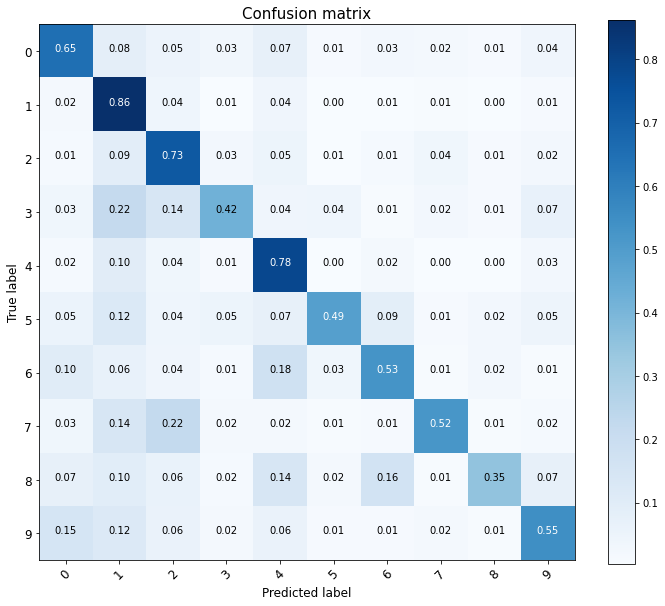

In [ ]:
evaluate_model(labels_baseline, preds_baseline, list(range(10)))

### My proposal

In [ ]:
class CNN(pl.LightningModule):
    def __init__(self, n_classes):
        super().__init__()
        self.layer1 = nn.Conv2d(1, 16, 3)
        self.bn1 = nn.BatchNorm2d(16)
        self.layer2 = nn.Conv2d(16, 32, 3)
        self.bn2 = nn.BatchNorm2d(32)
        self.layer3 = nn.Conv2d(32, 64, 3)
        self.bn3 = nn.BatchNorm2d(64)
        self.activation = nn.ReLU()
        self.mxpool = nn.MaxPool2d(2)
        self.dropout = nn.Dropout(0.1)
        self.flat = nn.Flatten()
        self.fc1 = nn.Linear(256, 128)
        self.fc2 = nn.Linear(128, 64)
        self.fc3 = nn.Linear(64, n_classes)

        self.loss = nn.CrossEntropyLoss()
        self.train_accuracy = torchmetrics.Accuracy()
        self.val_accuracy = torchmetrics.Accuracy()

    def forward(self,x):
        out = self.bn1(self.activation(self.layer1(x)))
        out = self.mxpool(out)
        out = self.bn2(self.activation(self.layer2(out)))
        out = self.mxpool(out)
        out = self.bn3(self.activation(self.layer3(out)))
        out = self.mxpool(out)
        out = self.flat(out)
        out = self.activation(self.fc1(out))
        out = self.dropout(out)
        out = self.activation(self.fc2(out))
        out = self.dropout(out)
        out = self.fc3(out)
        return out

    def configure_optimizers(self):
        optimizer = torch.optim.SGD(self.parameters(), lr=5e-2)
        scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, patience=3, threshold=0.01, threshold_mode='abs')
        return { 'optimizer': optimizer, 'lr_scheduler': scheduler, 'monitor': 'train/acc' }
    
    def compute_step(self,batch):
        imgs, labels = batch
        label_logits = self.forward(imgs)
        _,label_predictions = torch.max(label_logits, dim=1)
        return self.loss(label_logits,labels), labels, label_predictions
    
    def training_step(self, train_batch, batch_idx):
        self.train()
        loss, labels, label_predictions = self.compute_step(train_batch)
        self.train_accuracy(label_predictions, labels)
        self.log_dict({"train/loss": loss, 'train/acc' : self.train_accuracy}, 
                  on_step=False, 
                  on_epoch=True, 
                  prog_bar=True)
        return loss
    
    def validation_step(self, val_batch, batch_idx):
        self.eval()
        loss, labels, label_predictions = self.compute_step(val_batch)
        self.val_accuracy(label_predictions, labels)
        self.log_dict({"val/loss": loss, 'val/acc' : self.val_accuracy}, 
                  on_step=False, 
                  on_epoch=True, 
                  prog_bar=True)
        return loss

In [ ]:
train_data_ex1 = SVHNDataset('./data','train_task1',
                             transform=transforms.Compose([
                                        transforms.ToTensor(), 
                                        transforms.Grayscale(1)
                                    ]))
test_data_ex1 = SVHNDataset('./data','test_task1',
                            transform=transforms.Compose([
                                        transforms.ToTensor(), 
                                        transforms.Grayscale(1)
                                    ]))

train_loader = DataLoader(train_data_ex1, batch_size=64, shuffle=True)
test_loader = DataLoader(test_data_ex1, batch_size=64, shuffle=False)

in_features = 32*32*1
n_classes = 10 
model = CNN(n_classes)

tb_logger = pl_loggers.TensorBoardLogger("./logs/", name='task1-lcambero')
trainer = pl.Trainer(gpus=1, max_epochs=20, logger=tb_logger)
trainer.fit(model, 
           train_loader, 
           test_loader)

Loaded SVHN split: train_task1
-------------------------------------
Images Size:  (32, 32, 3)
Split Number of Images: 73257
Split Labels Array Size: (73257,)
Possible Labels:  [ 1  2  3  4  5  6  7  8  9 10]


GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

   | Name           | Type             | Params
-----------------------------------------------------
0  | layer1         | Conv2d           | 160   
1  | bn1            | BatchNorm2d      | 32    
2  | layer2         | Conv2d           | 4.6 K 
3  | bn2            | BatchNorm2d      | 64    
4  | layer3         | Conv2d           | 18.5 K
5  | bn3            | BatchNorm2d      | 128   
6  | activation     | ReLU             | 0     
7  | mxpool         | MaxPool2d        | 0     
8  | dropout        | Dropout          | 0     
9  | flat           | Flatten          | 0     
10 | fc1            | Linear           | 32.9 K
11 | fc2            | Linear           | 8.3 K 
12 | fc3            | Linear           | 650   
13 | loss           | CrossEntropyLoss | 0     
14 | train_accuracy | Accuracy        

Loaded SVHN split: test_task1
-------------------------------------
Images Size:  (32, 32, 3)
Split Number of Images: 26032
Split Labels Array Size: (26032,)
Possible Labels:  [ 1  2  3  4  5  6  7  8  9 10]


Sanity Checking: 0it [00:00, ?it/s]

/usr/local/lib/python3.7/dist-packages/torchmetrics/utilities/prints.py:36: UserWarning: Torchmetrics v0.9 introduced a new argument class property called `full_state_update` that has
                not been set for this class (_ResultMetric). The property determines if `update` by
                default needs access to the full metric state. If this is not the case, significant speedups can be
                achieved and we recommend setting this to `False`.
                We provide an checking function
                `from torchmetrics.utilities import check_forward_no_full_state`
                that can be used to check if the `full_state_update=True` (old and potential slower behaviour,
                default for now) or if `full_state_update=False` can be used safely.
                
  warnings.warn(*args, **kwargs)


Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

In [ ]:
# Get model predictions
model.eval()

labels = []
preds = []
for idx in tqdm(range(len(test_data_ex1))):
    image, label = test_data_ex1.__getitem__(idx)
    image = image.unsqueeze(0)
    label_logits = model.forward(image)
    _, label_predictions = torch.max(label_logits, dim=1)
    preds.append(label_predictions.detach().numpy()[0])
    labels.append(label)

100%|██████████| 26032/26032 [00:19<00:00, 1312.96it/s]


(accuracy, f1) are: (0.915911, 0.915938)
              precision    recall  f1-score   support

           0       0.92      0.91      0.91      1744
           1       0.94      0.95      0.94      5099
           2       0.94      0.93      0.94      4149
           3       0.89      0.89      0.89      2882
           4       0.93      0.92      0.93      2523
           5       0.91      0.91      0.91      2384
           6       0.88      0.90      0.89      1977
           7       0.93      0.91      0.92      2019
           8       0.90      0.87      0.89      1660
           9       0.86      0.91      0.88      1595

    accuracy                           0.92     26032
   macro avg       0.91      0.91      0.91     26032
weighted avg       0.92      0.92      0.92     26032



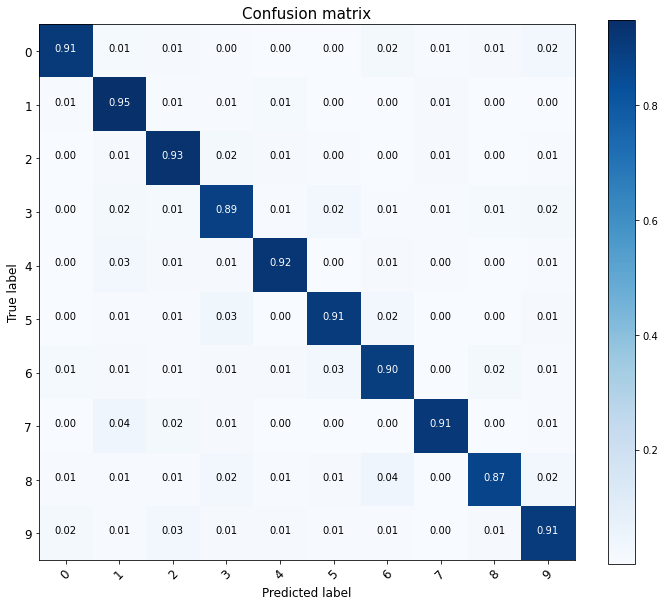

In [ ]:
evaluate_model(labels, preds, list(range(10)))

### T1.2 - Training and testing results visualized on tensorboard

In [ ]:
# Load the TensorBoard notebook extension
%reload_ext tensorboard
%tensorboard --logdir logs

<IPython.core.display.Javascript object>

As can be observed, the baseline model contains 196K parameters which is under the contraints given by the exercise.
Additionally, the model achieves around a 60% accuracy on the validation set as can be visualized in the Tensorboad Dashboard

<font color='red'>COMMENTS</font>

My proposal is based on the use of a more specific neural network for images, like Convolutional Neural Networks. Due to exercise constraints, I have used a basic CNN architecture with 3 convolutional layers to extract features from the images and 3 fully connected layers to classify images. I have added batch normalization to speed up the training and dropout to improve generalization.

The images have been converted to grayscale, to compress the color info in one channel to reduce the number of parameters needed, and because the color of the number or the color of the background is not important in the task, only the contrast between both, which generates the visual pattern that we need to classify the images. 

CNN uses only 65K parameters, which is approximately 67% less than MLP, and achieves better classification metrics for all the classes, and therefore, a better global accuracy, reaching 91% of accuracy, which is approximately 46% improvement.




# Task 2 - Image Classification with scarce training data
In this task, the goal is to create a model which is able to perform binary classification and differentiate between images depicting the digit 0 or 1. For this purpose, you are provided with:
1. A training set containing images with digits from 2 to 9. This dataset is large and is composed by a total of XXX examples. 
2. A training set containing images with digits from 0 to 1. This split is small and only contains XXX examples.
3. A testing set with image digits from 0 to 1. This dataset is larger than the previous one and must be used for evaluation purposes. 

With the provided data, train the model classifying 0 and 1s and evaluate its performance in terms of accuracy. Your goal is to obtain the maximum possible accuracy in the testing set by following the model constratints described in Task 1.

### T2.1 - Loading datasets from the different splits 

In [ ]:
train_29_imgs, train_29_labels = load_data('./data','train_29_task2')
train_01_imgs, train_01_labels = load_data('./data','train_01_task2')
test_01_imgs, test_01_labels = load_data('./data','test_01_task2')

Loaded SVHN split: train_29_task2
-------------------------------------
Images Size:  (32, 32, 3)
Split Number of Images: 54448
Split Labels Array Size: (54448,)
Possible Labels:  [2 3 4 5 6 7 8 9]
Loaded SVHN split: train_01_task2
-------------------------------------
Images Size:  (32, 32, 3)
Split Number of Images: 200
Split Labels Array Size: (200,)
Possible Labels:  [ 1 10]
Loaded SVHN split: test_01_task2
-------------------------------------
Images Size:  (32, 32, 3)
Split Number of Images: 6643
Split Labels Array Size: (6643,)
Possible Labels:  [ 1 10]


## My proposal

<font color='red'>COMMENTS</font> 

My proposal is based on a transfer learning strategy. Train a CNN (similar to the one of task 1 to accomplish with exercise constraints) using data from classes 2 to 9, which are enough to ensure that the CNN learns how to extract useful features from the images. Then, all the layers of this CNN are frozen, so they will not update anymore, and the last layer, the classifier, is changed by a new classifier for the specific binary classification. Now, even if we have few training data, the trainable params will be scarce and easy for CNN to learn just a new classification (feature extraction is already trained).


In [ ]:
class CNN(pl.LightningModule):
    def __init__(self, n_classes):
        super().__init__()
        self.layer1 = nn.Conv2d(1, 16, 3)
        self.bn1 = nn.BatchNorm2d(16)
        self.layer2 = nn.Conv2d(16, 32, 3)
        self.bn2 = nn.BatchNorm2d(32)
        self.layer3 = nn.Conv2d(32, 64, 3)
        self.bn3 = nn.BatchNorm2d(64)
        self.activation = nn.ReLU()
        self.mxpool = nn.MaxPool2d(2)
        self.dropout = nn.Dropout(0.1)
        self.flat = nn.Flatten()
        self.fc1 = nn.Linear(256, 128)
        self.fc2 = nn.Linear(128, 64)
        self.fc3 = nn.Linear(64, n_classes)

        self.loss = nn.CrossEntropyLoss()
        self.train_accuracy = torchmetrics.Accuracy()
        self.val_accuracy = torchmetrics.Accuracy()

    def forward(self,x):
        out = self.bn1(self.activation(self.layer1(x)))
        out = self.mxpool(out)
        out = self.bn2(self.activation(self.layer2(out)))
        out = self.mxpool(out)
        out = self.bn3(self.activation(self.layer3(out)))
        out = self.mxpool(out)
        out = self.flat(out)
        out = self.activation(self.fc1(out))
        out = self.dropout(out)
        out = self.activation(self.fc2(out))
        out = self.dropout(out)
        out = self.fc3(out)
        return out

    def configure_optimizers(self):
        optimizer = torch.optim.SGD(self.parameters(), lr=5e-2)
        scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, patience=3, threshold=0.01, threshold_mode='abs')
        return { 'optimizer': optimizer, 'lr_scheduler': scheduler, 'monitor': 'train/acc' }
    
    def compute_step(self,batch):
        imgs, labels = batch
        label_logits = self.forward(imgs)
        _,label_predictions = torch.max(label_logits, dim=1)
        return self.loss(label_logits,labels), labels, label_predictions
    
    def training_step(self, train_batch, batch_idx):
        self.train()
        loss, labels, label_predictions = self.compute_step(train_batch)
        self.train_accuracy(label_predictions, labels)
        self.log_dict({"train/loss": loss, 'train/acc' : self.train_accuracy}, 
                  on_step=False, 
                  on_epoch=True, 
                  prog_bar=True)
        return loss
    
    def validation_step(self, val_batch, batch_idx):
        self.eval()
        loss, labels, label_predictions = self.compute_step(val_batch)
        self.val_accuracy(label_predictions, labels)
        self.log_dict({"val/loss": loss, 'val/acc' : self.val_accuracy}, 
                  on_step=False, 
                  on_epoch=True, 
                  prog_bar=True)
        return loss

### Baseline

In [ ]:
class SVHNDataset(Dataset):

    def __init__(self, 
                 root_dir, 
                 split, 
                 transform=None):
        self.images, self.labels = load_data(root_dir, split)
        self.transform = transform
        
    def __len__(self):
        return len(self.labels)

    def __getitem__(self, index):
        img, target = self.images[:,:,:,index], int(self.labels[index])
        if self.transform:
            img = self.transform(img)
        return img, 1 if target == 1 else 0

train_data_ex2_01 = SVHNDataset('./data','train_01_task2',
                             transform=transforms.Compose([
                                        transforms.ToTensor(), 
                                        transforms.Grayscale(1)
                                    ]))


test_data_ex2_01 = SVHNDataset('./data','test_01_task2',
                            transform=transforms.Compose([
                                        transforms.ToTensor(), 
                                        transforms.Grayscale(1)
                                    ]))

train_loader = DataLoader(train_data_ex2_01, batch_size=64, shuffle=True)
test_loader = DataLoader(test_data_ex2_01, batch_size=64, shuffle=False)

n_classes = 2
model_baseline = CNN(n_classes)

tb_logger = pl_loggers.TensorBoardLogger("./logs/", name='task2-baseline')
trainer = pl.Trainer(gpus=1, max_epochs=10, logger=tb_logger)
trainer.fit(model_baseline, 
           train_loader,
           test_loader)

Loaded SVHN split: train_01_task2
-------------------------------------
Images Size:  (32, 32, 3)
Split Number of Images: 200
Split Labels Array Size: (200,)
Possible Labels:  [ 1 10]


GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Loaded SVHN split: test_01_task2
-------------------------------------
Images Size:  (32, 32, 3)
Split Number of Images: 6643
Split Labels Array Size: (6643,)
Possible Labels:  [ 1 10]


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

   | Name           | Type             | Params
-----------------------------------------------------
0  | layer1         | Conv2d           | 160   
1  | bn1            | BatchNorm2d      | 32    
2  | layer2         | Conv2d           | 4.6 K 
3  | bn2            | BatchNorm2d      | 64    
4  | layer3         | Conv2d           | 18.5 K
5  | bn3            | BatchNorm2d      | 128   
6  | activation     | ReLU             | 0     
7  | mxpool         | MaxPool2d        | 0     
8  | dropout        | Dropout          | 0     
9  | flat           | Flatten          | 0     
10 | fc1            | Linear           | 32.9 K
11 | fc2            | Linear           | 8.3 K 
12 | fc3            | Linear           | 130   
13 | loss           | CrossEntropyLoss | 0     
14 | train_accuracy | Accuracy         | 0     
15 | val_accuracy   | Accuracy         | 0     
-----------------------------------------------------
64.8 K    Trainable params
0     

Sanity Checking: 0it [00:00, ?it/s]

/usr/local/lib/python3.7/dist-packages/torchmetrics/utilities/prints.py:36: UserWarning: Torchmetrics v0.9 introduced a new argument class property called `full_state_update` that has
                not been set for this class (_ResultMetric). The property determines if `update` by
                default needs access to the full metric state. If this is not the case, significant speedups can be
                achieved and we recommend setting this to `False`.
                We provide an checking function
                `from torchmetrics.utilities import check_forward_no_full_state`
                that can be used to check if the `full_state_update=True` (old and potential slower behaviour,
                default for now) or if `full_state_update=False` can be used safely.
                
  warnings.warn(*args, **kwargs)
/usr/local/lib/python3.7/dist-packages/pytorch_lightning/trainer/trainer.py:1937: PossibleUserWarning: The number of training batches (4) is smaller than the 

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

In [ ]:
# Get model predictions
model_baseline.eval()

labels = []
preds = []
for idx in tqdm(range(len(test_data_ex2_01))):
    image, label = test_data_ex2_01.__getitem__(idx)
    image = image.unsqueeze(0)
    label_logits = model_baseline.forward(image)
    _, label_predictions = torch.max(label_logits, dim=1)
    preds.append(label_predictions.detach().numpy()[0])
    labels.append(label)

100%|██████████| 6643/6643 [00:05<00:00, 1242.81it/s]


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


(accuracy, f1) are: (0.744694, 0.635720)
              precision    recall  f1-score   support

           0       0.00      0.00      0.00      1696
           1       0.74      1.00      0.85      4947

    accuracy                           0.74      6643
   macro avg       0.37      0.50      0.43      6643
weighted avg       0.55      0.74      0.64      6643



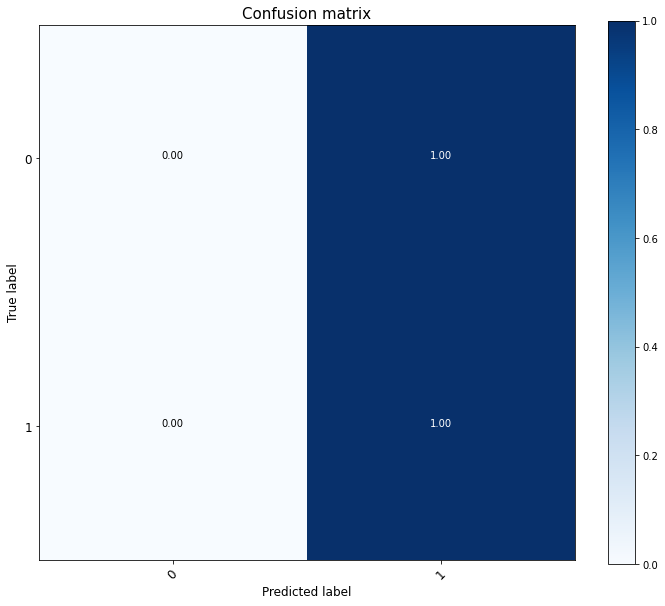

In [ ]:
evaluate_model(labels, preds, [0, 1])

<font color='red'>COMMENTS</font> 

A CNN has been trained from scratch using the scarce training set to use it as task baseline. 

We can see how, even the global accuracy results seem great, but that is because class 1 has more than double samples than class 0, so the model always predicts 1 and it is accurate easily in 75% of the predictions, but is just a mathematical trick, the model is not learning anything.


### Transfer learning

In [ ]:
# CNN trained to be the feature extractor of the later binary classifier

class SVHNDataset(Dataset):

    def __init__(self, 
                 root_dir, 
                 split, 
                 transform=None):
        self.images, self.labels = load_data(root_dir, split)
        self.transform = transform
        
    def __len__(self):
        return len(self.labels)

    def __getitem__(self, index):
        img, target = self.images[:,:,:,index], int(self.labels[index])
        if self.transform:
            img = self.transform(img)
        return img, target-2


train_data_ex2_29 = SVHNDataset('./data','train_29_task2',
                             transform=transforms.Compose([
                                        transforms.ToTensor(), 
                                        transforms.Grayscale(1),
                                    ]))


train_loader = DataLoader(train_data_ex2_29, batch_size=64, shuffle=True)

in_features = 32*32*1
n_classes = 8 
model_feature_extractor = CNN(n_classes)

tb_logger = pl_loggers.TensorBoardLogger("./logs/", name='task2-featureextractor')
trainer = pl.Trainer(gpus=1, max_epochs=10, logger=tb_logger)
trainer.fit(model_feature_extractor, train_loader)

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/usr/local/lib/python3.7/dist-packages/pytorch_lightning/trainer/configuration_validator.py:133: UserWarning: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
  rank_zero_warn("You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.")
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

   | Name           | Type             | Params
-----------------------------------------------------
0  | layer1         | Conv2d           | 160   
1  | bn1            | BatchNorm2d      | 32    
2  | layer2         | Conv2d           | 4.6 K 
3  | bn2            | BatchNorm2d      | 64    
4  | layer3         | Conv2d           | 18.5 K
5  | bn3            | BatchNorm2d      | 128   
6  | activation     | ReLU             | 0     
7  | mxpool         | MaxPool2d        | 0     
8  | dropout        | Dropout     

Loaded SVHN split: train_29_task2
-------------------------------------
Images Size:  (32, 32, 3)
Split Number of Images: 54448
Split Labels Array Size: (54448,)
Possible Labels:  [2 3 4 5 6 7 8 9]


Training: 0it [00:00, ?it/s]

/usr/local/lib/python3.7/dist-packages/torchmetrics/utilities/prints.py:36: UserWarning: Torchmetrics v0.9 introduced a new argument class property called `full_state_update` that has
                not been set for this class (_ResultMetric). The property determines if `update` by
                default needs access to the full metric state. If this is not the case, significant speedups can be
                achieved and we recommend setting this to `False`.
                We provide an checking function
                `from torchmetrics.utilities import check_forward_no_full_state`
                that can be used to check if the `full_state_update=True` (old and potential slower behaviour,
                default for now) or if `full_state_update=False` can be used safely.
                
  warnings.warn(*args, **kwargs)


In [ ]:
import copy

# Freeze all the model trained to extract features from images
for param in model_feature_extractor.parameters():
    param.requires_grad = False

# Replace the classifier for the new task
n_classes = 2
model_feature_extractor.fc3 = nn.Linear(64, n_classes)

model_binary_classification = copy.deepcopy(model_feature_extractor)

/usr/local/lib/python3.7/dist-packages/torchmetrics/utilities/prints.py:36: UserWarning: Torchmetrics v0.9 introduced a new argument class property called `full_state_update` that has
                not been set for this class (_ResultMetric). The property determines if `update` by
                default needs access to the full metric state. If this is not the case, significant speedups can be
                achieved and we recommend setting this to `False`.
                We provide an checking function
                `from torchmetrics.utilities import check_forward_no_full_state`
                that can be used to check if the `full_state_update=True` (old and potential slower behaviour,
                default for now) or if `full_state_update=False` can be used safely.
                
  warnings.warn(*args, **kwargs)


In [ ]:
# Train the binary classifier where only the last layer will be trained
# The rest of the model is frozen. It can be checked in trainable params summary, only 130.


class SVHNDataset(Dataset):

    def __init__(self, 
                 root_dir, 
                 split, 
                 transform=None):
        self.images, self.labels = load_data(root_dir, split)
        self.transform = transform
        
    def __len__(self):
        return len(self.labels)

    def __getitem__(self, index):
        img, target = self.images[:,:,:,index], int(self.labels[index])
        if self.transform:
            img = self.transform(img)
        return img, 1 if target == 1 else 0

train_data_ex2_01 = SVHNDataset('./data','train_01_task2',
                             transform=transforms.Compose([
                                        transforms.ToTensor(), 
                                        transforms.Grayscale(1)
                                    ]))


test_data_ex2_01 = SVHNDataset('./data','test_01_task2',
                            transform=transforms.Compose([
                                        transforms.ToTensor(), 
                                        transforms.Grayscale(1)
                                    ]))

train_loader = DataLoader(train_data_ex2_01, batch_size=64, shuffle=True)
test_loader = DataLoader(test_data_ex2_01, batch_size=64, shuffle=False)

tb_logger = pl_loggers.TensorBoardLogger("./logs/", name='task2-binaryclassifier')
trainer = pl.Trainer(gpus=1, max_epochs=10, logger=tb_logger)
trainer.fit(model_binary_classification, 
           train_loader,
           test_loader)

Loaded SVHN split: train_01_task2
-------------------------------------
Images Size:  (32, 32, 3)
Split Number of Images: 200
Split Labels Array Size: (200,)
Possible Labels:  [ 1 10]


GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Loaded SVHN split: test_01_task2
-------------------------------------
Images Size:  (32, 32, 3)
Split Number of Images: 6643
Split Labels Array Size: (6643,)
Possible Labels:  [ 1 10]


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

   | Name           | Type             | Params
-----------------------------------------------------
0  | layer1         | Conv2d           | 160   
1  | bn1            | BatchNorm2d      | 32    
2  | layer2         | Conv2d           | 4.6 K 
3  | bn2            | BatchNorm2d      | 64    
4  | layer3         | Conv2d           | 18.5 K
5  | bn3            | BatchNorm2d      | 128   
6  | activation     | ReLU             | 0     
7  | mxpool         | MaxPool2d        | 0     
8  | dropout        | Dropout          | 0     
9  | flat           | Flatten          | 0     
10 | fc1            | Linear           | 32.9 K
11 | fc2            | Linear           | 8.3 K 
12 | fc3            | Linear           | 130   
13 | loss           | CrossEntropyLoss | 0     
14 | train_accuracy | Accuracy         | 0     
15 | val_accuracy   | Accuracy         | 0     
-----------------------------------------------------
130       Trainable params
64.7 K

Sanity Checking: 0it [00:00, ?it/s]

/usr/local/lib/python3.7/dist-packages/torchmetrics/utilities/prints.py:36: UserWarning: Torchmetrics v0.9 introduced a new argument class property called `full_state_update` that has
                not been set for this class (_ResultMetric). The property determines if `update` by
                default needs access to the full metric state. If this is not the case, significant speedups can be
                achieved and we recommend setting this to `False`.
                We provide an checking function
                `from torchmetrics.utilities import check_forward_no_full_state`
                that can be used to check if the `full_state_update=True` (old and potential slower behaviour,
                default for now) or if `full_state_update=False` can be used safely.
                
  warnings.warn(*args, **kwargs)
/usr/local/lib/python3.7/dist-packages/pytorch_lightning/trainer/trainer.py:1937: PossibleUserWarning: The number of training batches (4) is smaller than the 

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

In [ ]:
# Get model predictions
model_binary_classification.eval()

labels = []
preds = []
for idx in tqdm(range(len(test_data_ex2_01))):
    image, label = test_data_ex2_01.__getitem__(idx)
    image = image.unsqueeze(0)
    label_logits = model_binary_classification.forward(image)
    _, label_predictions = torch.max(label_logits, dim=1)
    preds.append(label_predictions.detach().numpy()[0])
    labels.append(label)

100%|██████████| 6643/6643 [00:05<00:00, 1324.16it/s]


(accuracy, f1) are: (0.917808, 0.914097)
              precision    recall  f1-score   support

           0       0.94      0.73      0.82      1696
           1       0.91      0.98      0.95      4947

    accuracy                           0.92      6643
   macro avg       0.93      0.85      0.88      6643
weighted avg       0.92      0.92      0.91      6643



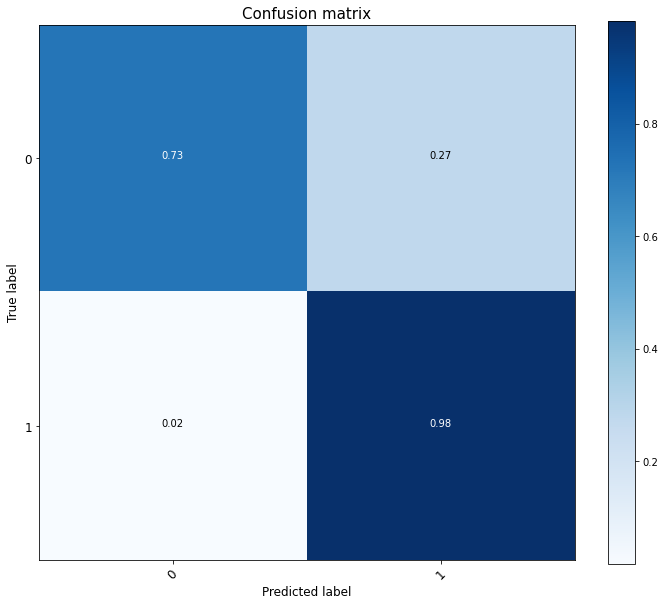

In [ ]:
evaluate_model(labels, preds, [0, 1])

In [ ]:
# Load the TensorBoard notebook extension
%reload_ext tensorboard
%tensorboard --logdir logs

<IPython.core.display.Javascript object>

<font color='red'>COMMENTS</font> 

Now we can see how, by transferring the previously trained feature extractor to the binary classifier, the results increase significantly. Moreover, the model trainig is really fast as it only has 130 trainable params.

Looking at the confusion matrix, the improvement is clear. Now when the model predicts a 0, we can be really sure that the image is really a 0, and also we can be really sure that nearly all the images of class 1 will be correctly classified. Only when the model predicts a 1 it is possible that the image will be really a 0, due to an imbalanced training dataset.

The model could still be improved by smoothing the imbalanced dataset, collecting more samples for 0 class (or trying artificially generating new samples).


# Task 3 - Image Classification with unlabelled training data
In this task, you are provided with the following data splits:

1. An unlabelled set containing images with digits from 0 to 9. This dataset corresponds to the original SVHN training set.  
2. A small subset of 50 unlabelled images with digits also ranging from 0 to 9.

Given any query image $\mathbf{x}$ in the small unlabelled dataset, your goal is to estimate what are the 5 most similar images in the large unlabelled dataset. Intuitively, you are interested in retrieving images which contain the same digit than the query image. For instance, if the query image contains the digit 0, you would like that the 5 retrieved images depict the number 0. 

The goal is to maximize a metric measuring the percentage of retrieved images that correspond to the same digit label than the query image. 
However, it is important to  remember that both splits are assumed to not be annotated and that you can only use the provided labels for evaluation purposes.

### T3.1 - Solution example comparing images using euclidean distance
In the following, we provide a simple solution to this problem by:
1. Computing the distance in terms of L2 distance between the  query image and all the images in the large unlabelled dataset.
2. Retrieving the top 5 images with the minimum distance.

We also provide an example of how to visualize results and compute the target metric. 

In [ ]:
# Load both splits
unlabelled_imgs, unlabelled_labels = load_data('./data','unlabelled_task3')
test_imgs, test_labels = load_data('./data','test_task3')

# Vectorize all the images in both splits
unlabelled_imgs_T = unlabelled_imgs.reshape(-1,unlabelled_imgs.shape[-1]).T
test_imgs_T = test_imgs.reshape(-1,test_imgs.shape[-1]).T

Loaded SVHN split: unlabelled_task3
-------------------------------------
Images Size:  (32, 32, 3)
Split Number of Images: 73257
Split Labels Array Size: (73257,)
Possible Labels:  [ 1  2  3  4  5  6  7  8  9 10]
Loaded SVHN split: test_task3
-------------------------------------
Images Size:  (32, 32, 3)
Split Number of Images: 50
Split Labels Array Size: (50,)
Possible Labels:  [ 1  2  3  4  5  6  8  9 10]


Query Image


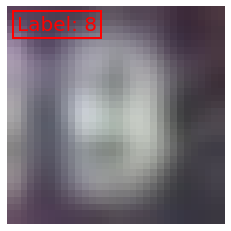

Retrieved Similar Images


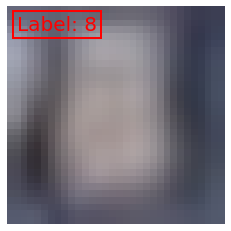

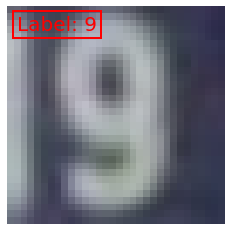

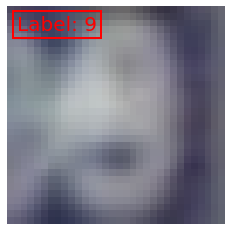

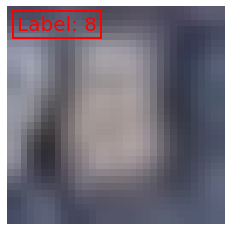

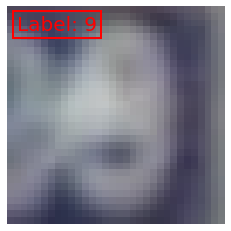

In [ ]:
# Visualize the TOP5 retrieved images for a given quary using euclidean distance-based similarity
K = 5

# Load a given query image form the test set
img_idx = 30
img = test_imgs_T[img_idx,:]


# Compute euclidean metric
distances = ((unlabelled_imgs_T-img)**2).sum(axis=1)

# Get top10 most similar images
similar_img_idx = (distances).argsort()[:K]

# Visualize images
print('Query Image')
visualize_image(test_imgs, test_labels,
                img_idx)
print('Retrieved Similar Images')
for idx in similar_img_idx:
    visualize_image(unlabelled_imgs, unlabelled_labels,
                    idx)
    


In [ ]:
img_accuracies = [] 
K = 5
N = test_imgs_T.shape[0]
for img_idx in range(0,N):
    img = test_imgs_T[img_idx,:]
    distances = ((unlabelled_imgs_T-img)**2).sum(axis=1)
    idx = (distances).argsort()[:K]
    similar_img_labels = unlabelled_labels[idx]
    img_label = test_labels[img_idx]
    image_accuracy = (similar_img_labels==img_label).mean()
    img_accuracies.append(image_accuracy)
    print('Accuracy for test sample {idx} with label {label}  in TOP{K} retrieved images: {acc}'.format(idx=img_idx,
                                                                                                        label= img_label,
                                                                                                        K=K,
                                                                                                        acc = image_accuracy))

# Compute average accuracy over testing set    
average_acc = np.asarray(img_accuracies).mean()
print('Average Accuracy over the testing set: {acc}'.format(acc=average_acc))

Accuracy for test sample 0 with label 5  in TOP5 retrieved images: 0.0
Accuracy for test sample 1 with label 2  in TOP5 retrieved images: 0.6
Accuracy for test sample 2 with label 1  in TOP5 retrieved images: 0.8
Accuracy for test sample 3 with label 10  in TOP5 retrieved images: 0.0
Accuracy for test sample 4 with label 6  in TOP5 retrieved images: 0.4
Accuracy for test sample 5 with label 1  in TOP5 retrieved images: 0.6
Accuracy for test sample 6 with label 9  in TOP5 retrieved images: 0.2
Accuracy for test sample 7 with label 1  in TOP5 retrieved images: 0.8
Accuracy for test sample 8 with label 1  in TOP5 retrieved images: 0.8
Accuracy for test sample 9 with label 8  in TOP5 retrieved images: 0.2
Accuracy for test sample 10 with label 3  in TOP5 retrieved images: 0.0
Accuracy for test sample 11 with label 6  in TOP5 retrieved images: 0.2
Accuracy for test sample 12 with label 5  in TOP5 retrieved images: 0.2
Accuracy for test sample 13 with label 1  in TOP5 retrieved images: 0.8
A

### My proposal

<font color='red'>COMMENTS</font> 

My proposal is based on achieving the best possible embedding, that encodes the really important information on the image and removes noise. This ideally produces that the images with the same number will have similar (nearby) embeddings.

To achieve this goal, I will use a convolutional autoeconder, which learns to encode and decode an image, so therefore, it removes any unuseful information in the image and only keeps the really useful information to reconstruct the image from the encoding step.

Then, K nearest neighbors will be used to cluster similar image embeddings and retrieve the more similar images from a given image.

In [ ]:
class ConvAutoencoder(pl.LightningModule):
    def __init__(self):
        super(ConvAutoencoder, self).__init__()
        # Encoder layers
        self.conv1 = nn.Conv2d(1, 128, 3, padding=1)  
        self.bn1 = nn.BatchNorm2d(128)
        self.conv2 = nn.Conv2d(128, 256, 3, padding=1)
        self.bn2 = nn.BatchNorm2d(256)
        self.conv3 = nn.Conv2d(256, 512, 3, padding=1)
        self.bn3 = nn.BatchNorm2d(512)
        self.pool = nn.MaxPool2d(2)
        self.flat = nn.Flatten()
        self.fc1 = nn.Linear(8192, 256)

        # Decoder layers
        self.fc2 = nn.Linear(256, 8192)
        self.unflat = nn.Unflatten(1, torch.Size([512, 4, 4]))
        self.t_conv1 = nn.ConvTranspose2d(512, 256, 2, stride=2)
        self.bn4 = nn.BatchNorm2d(256)
        self.t_conv2 = nn.ConvTranspose2d(256, 128, 2, stride=2)
        self.bn5 = nn.BatchNorm2d(128)
        self.t_conv3 = nn.ConvTranspose2d(128, 1, 2, stride=2)

        self.dropout = nn.Dropout(0.1)
        self.activation = nn.ReLU()
        self.sigmoid = nn.Sigmoid()
        self.loss = nn.MSELoss()

    def forward(self, x):
        # print(x.shape)

        # Encode
        encoder = self.bn1(self.activation(self.conv1(x)))
        encoder = self.dropout(encoder)
        encoder = self.pool(encoder)
        encoder = self.bn2(self.activation(self.conv2(encoder)))
        encoder = self.dropout(encoder)
        encoder = self.pool(encoder)
        encoder = self.bn3(self.activation(self.conv3(encoder)))
        encoder = self.dropout(encoder)
        encoder = self.pool(encoder) 
        encoder = self.flat(encoder)

        embedding = self.activation(self.fc1(encoder)) # compressed representation
        # print(embedding.shape)

        # Decode
        decoder = self.activation(self.fc2(embedding))
        decoder = self.unflat(decoder)
        decoder = self.bn4(self.activation(self.t_conv1(decoder)))
        decoder = self.dropout(decoder)
        decoder = self.bn5(self.activation(self.t_conv2(decoder)))
        decoder = self.dropout(decoder)
        decoder = self.sigmoid(self.t_conv3(decoder))
                
        # print(decoder.shape)
        return decoder, embedding
    
    def configure_optimizers(self):
        optimizer = torch.optim.Adam(self.parameters(), lr=5e-4)
        scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, patience=5, threshold=0.001, threshold_mode='abs')
        return { 'optimizer': optimizer, 'lr_scheduler': scheduler, 'monitor': 'train/loss' }

    def compute_step(self,batch):
        imgs = batch
        outputs, embedding = self.forward(imgs)
        return self.loss(outputs, imgs)
    
    def training_step(self, train_batch, batch_idx):
        self.train()
        loss = self.compute_step(train_batch)
        self.log_dict({"train/loss": loss}, 
                  on_step=False, 
                  on_epoch=True, 
                  prog_bar=True)
        return loss
    
    def validation_step(self, val_batch, batch_idx):
        self.eval()
        loss = self.compute_step(val_batch)
        self.val_accuracy(label_predictions, labels)
        self.log_dict({"val/loss": loss}, 
                  on_step=False, 
                  on_epoch=True, 
                  prog_bar=True)
        return loss

In [ ]:
class SVHNDataset(Dataset):

    def __init__(self, 
                 root_dir, 
                 split, 
                 transform=None):
        self.images, self.labels = load_data(root_dir, split)
        self.transform = transform
        
    def __len__(self):
        return len(self.labels)

    def __getitem__(self, index):
        img, _ = self.images[:,:,:,index], int(self.labels[index])
        if self.transform:
            img = self.transform(img)
        return img


train_data_ex3 = SVHNDataset('./data','unlabelled_task3',
                             transform=transforms.Compose([
                                        transforms.ToTensor(), 
                                        transforms.Grayscale(1),
                                        transforms.RandomRotation(30),
                                        transforms.RandomVerticalFlip(), 
                                        transforms.RandomHorizontalFlip()
                                    ]))


test_data_ex3 = SVHNDataset('./data','test_task3',
                            transform=transforms.Compose([
                                        transforms.ToTensor(), 
                                        transforms.Grayscale(1)
                                    ]))

train_loader = DataLoader(train_data_ex3, batch_size=64, shuffle=True)
# test_loader = DataLoader(test_data_ex3, batch_size=64, shuffle=False)

model = ConvAutoencoder()

tb_logger = pl_loggers.TensorBoardLogger('./logs/', name='task3-convautoencoder')
trainer = pl.Trainer(gpus=1, max_epochs=25, logger=tb_logger)
trainer.fit(model, train_loader)

Loaded SVHN split: unlabelled_task3
-------------------------------------
Images Size:  (32, 32, 3)
Split Number of Images: 73257
Split Labels Array Size: (73257,)
Possible Labels:  [ 1  2  3  4  5  6  7  8  9 10]
Loaded SVHN split: test_task3
-------------------------------------
Images Size:  (32, 32, 3)
Split Number of Images: 50
Split Labels Array Size: (50,)
Possible Labels:  [ 1  2  3  4  5  6  8  9 10]


GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
Missing logger folder: ./logs/task3-convautoencoder
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

   | Name       | Type            | Params
------------------------------------------------
0  | conv1      | Conv2d          | 1.3 K 
1  | bn1        | BatchNorm2d     | 256   
2  | conv2      | Conv2d          | 295 K 
3  | bn2        | BatchNorm2d     | 512   
4  | conv3      | Conv2d          | 1.2 M 
5  | bn3        | BatchNorm2d     | 1.0 K 
6  | pool       | MaxPool2d       | 0     
7  | flat       | Flatten         | 0     
8  | fc1        | Linear          | 2.1 M 
9  | fc2        | Linear          | 2.1 M 
10 | unflat     | Unflatten       | 0     
11 | t_conv1    | ConvTranspose2d | 524 K 
12 | bn4        | BatchNorm2d     | 512   
13 | t_conv2    | ConvTranspose2d | 131 K 
14 | bn5        | BatchNorm2d     | 256   
15 | t_conv3    | ConvT

Training: 0it [00:00, ?it/s]

/usr/local/lib/python3.7/dist-packages/torchmetrics/utilities/prints.py:36: UserWarning: Torchmetrics v0.9 introduced a new argument class property called `full_state_update` that has
                not been set for this class (_ResultMetric). The property determines if `update` by
                default needs access to the full metric state. If this is not the case, significant speedups can be
                achieved and we recommend setting this to `False`.
                We provide an checking function
                `from torchmetrics.utilities import check_forward_no_full_state`
                that can be used to check if the `full_state_update=True` (old and potential slower behaviour,
                default for now) or if `full_state_update=False` can be used safely.
                
  warnings.warn(*args, **kwargs)


In [ ]:
# Load the TensorBoard notebook extension
%reload_ext tensorboard
%tensorboard --logdir logs

<IPython.core.display.Javascript object>

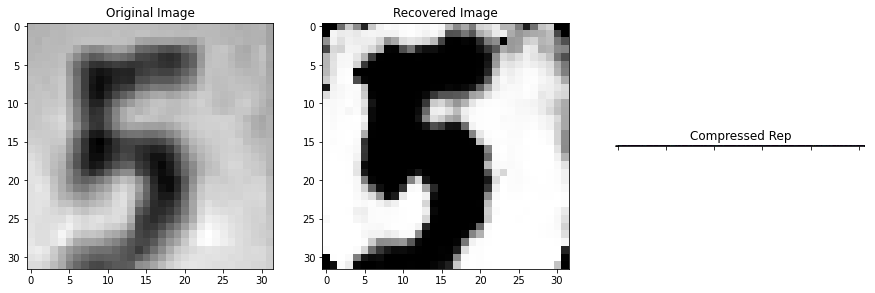

MSE tensor(0.2331, grad_fn=<SqueezeBackward0>)


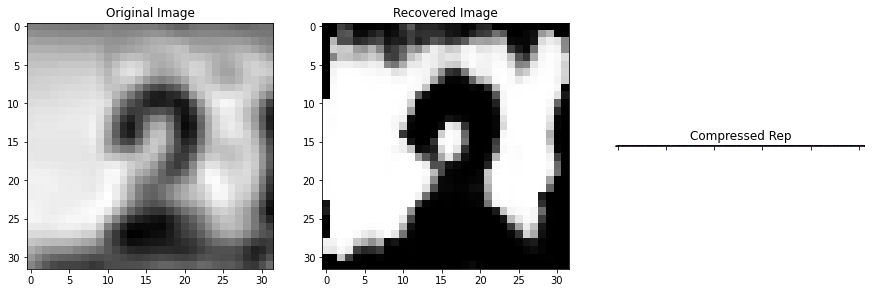

MSE tensor(0.1342, grad_fn=<SqueezeBackward0>)


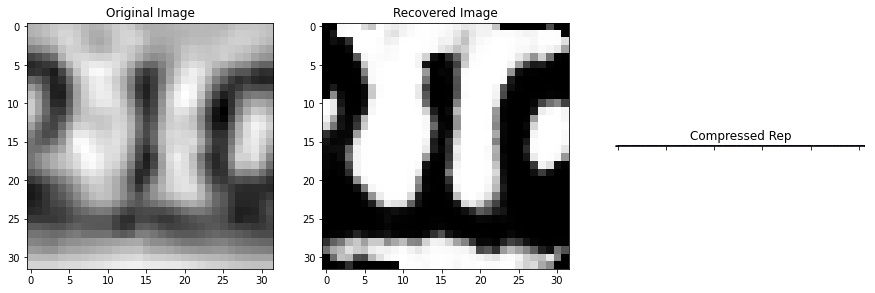

MSE tensor(0.1351, grad_fn=<SqueezeBackward0>)


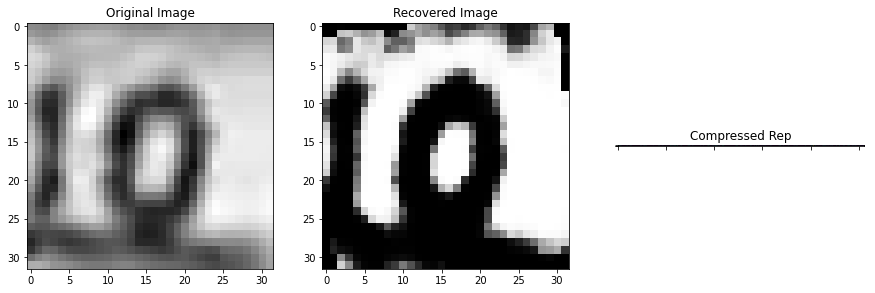

MSE tensor(0.1270, grad_fn=<SqueezeBackward0>)


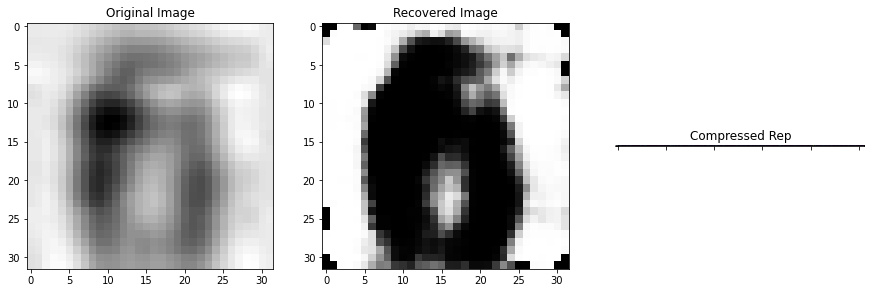

MSE tensor(0.1643, grad_fn=<SqueezeBackward0>)


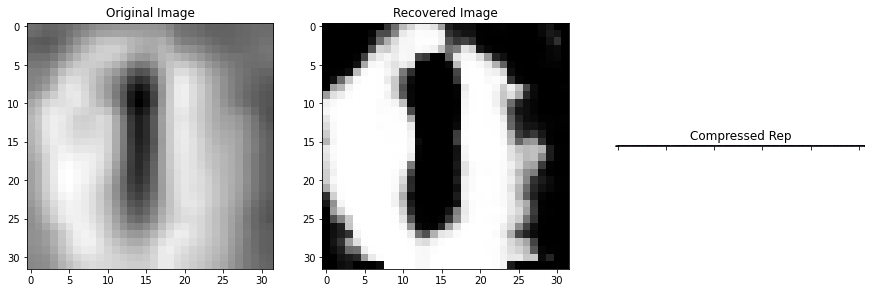

MSE tensor(0.1670, grad_fn=<SqueezeBackward0>)


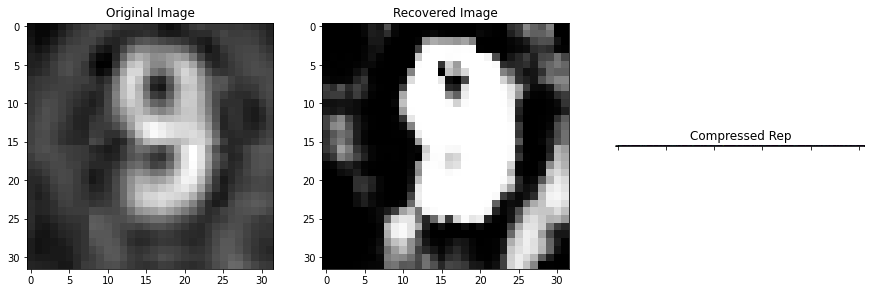

MSE tensor(0.2068, grad_fn=<SqueezeBackward0>)


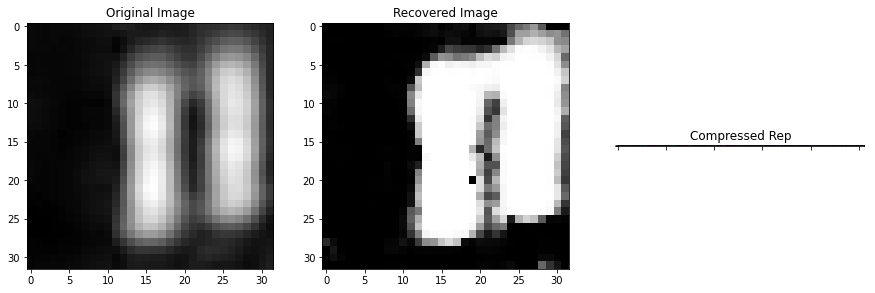

MSE tensor(0.1031, grad_fn=<SqueezeBackward0>)


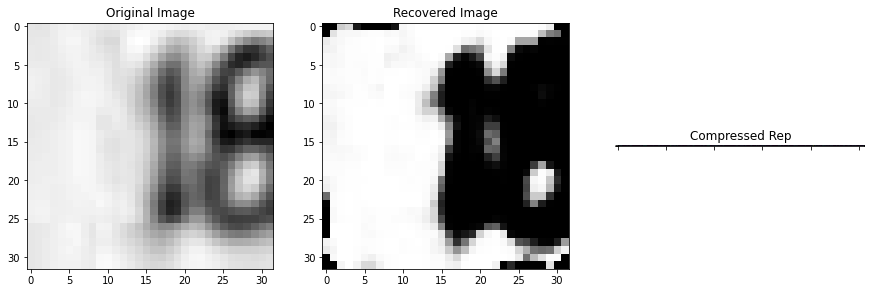

MSE tensor(0.1234, grad_fn=<SqueezeBackward0>)


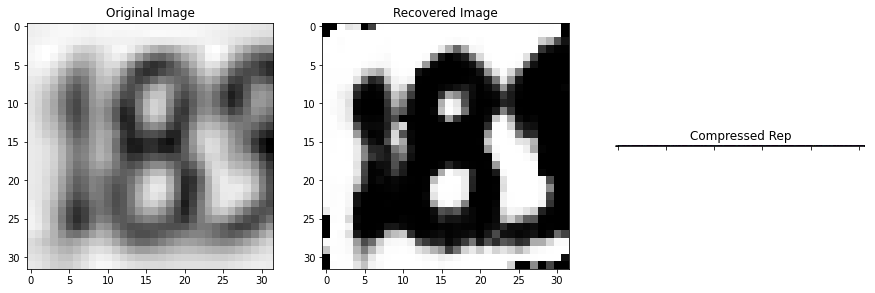

MSE tensor(0.1193, grad_fn=<SqueezeBackward0>)


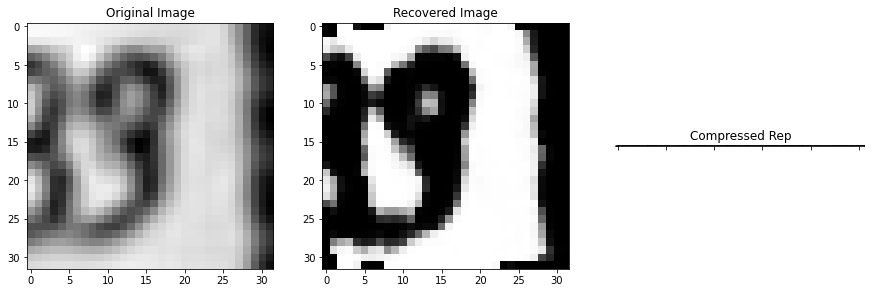

MSE tensor(0.1149, grad_fn=<SqueezeBackward0>)


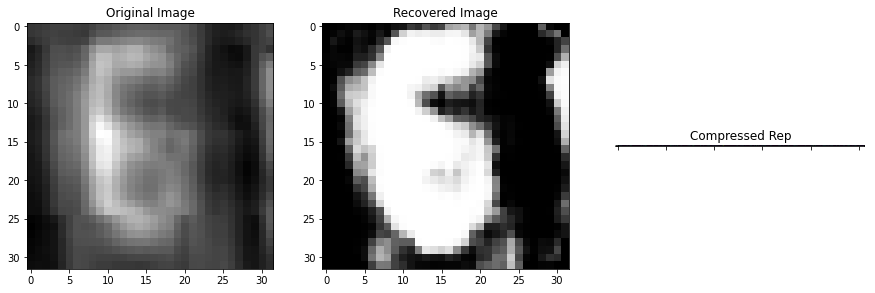

MSE tensor(0.1969, grad_fn=<SqueezeBackward0>)


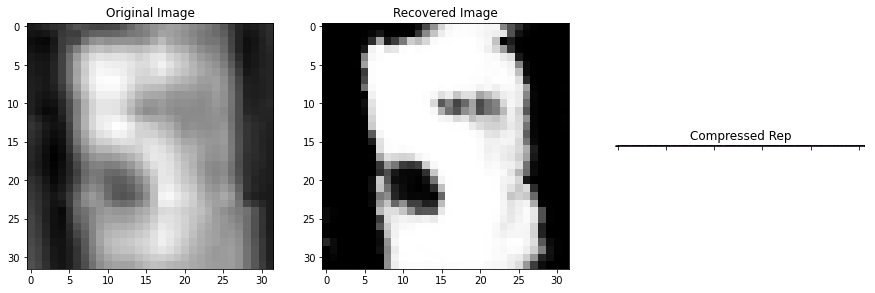

MSE tensor(0.2326, grad_fn=<SqueezeBackward0>)


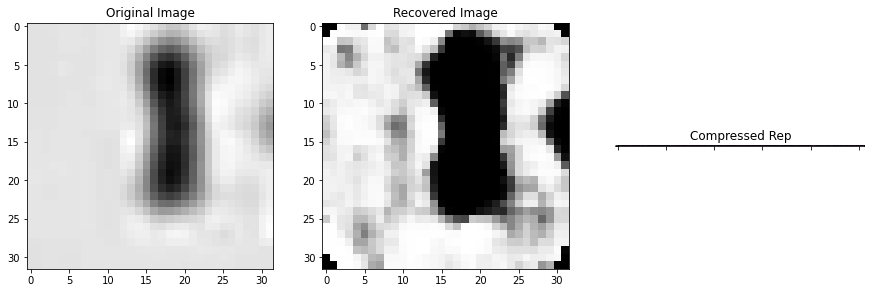

MSE tensor(0.0942, grad_fn=<SqueezeBackward0>)


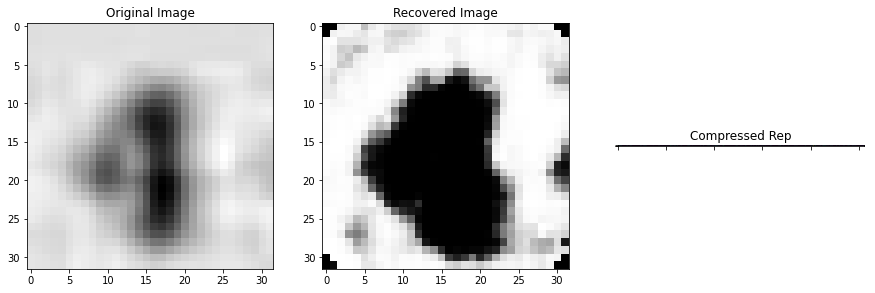

MSE tensor(0.1055, grad_fn=<SqueezeBackward0>)


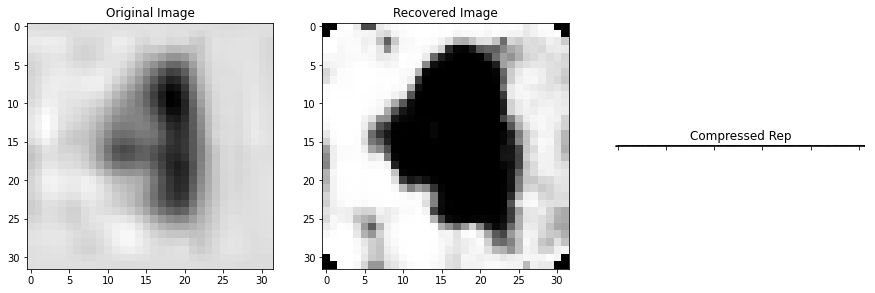

MSE tensor(0.1017, grad_fn=<SqueezeBackward0>)


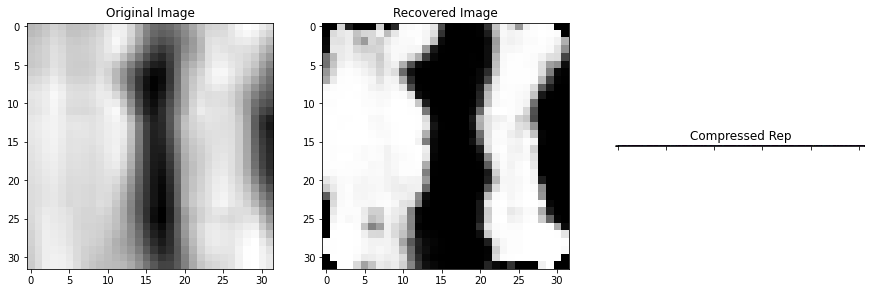

MSE tensor(0.1693, grad_fn=<SqueezeBackward0>)


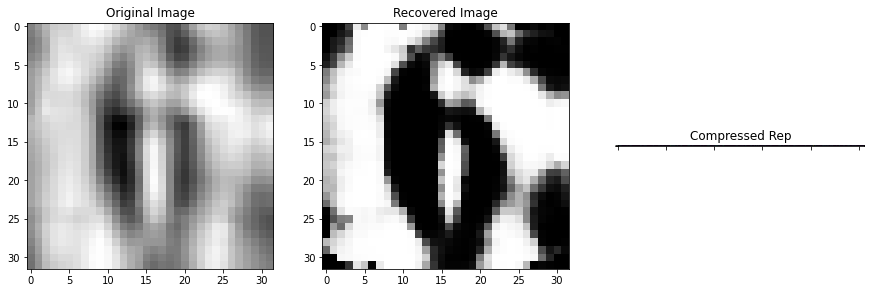

MSE tensor(0.2227, grad_fn=<SqueezeBackward0>)


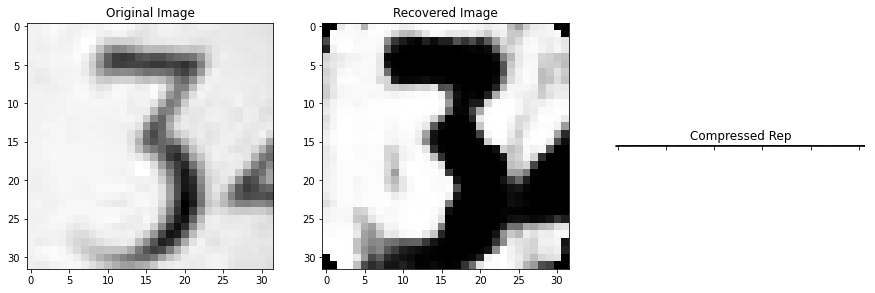

MSE tensor(0.1100, grad_fn=<SqueezeBackward0>)


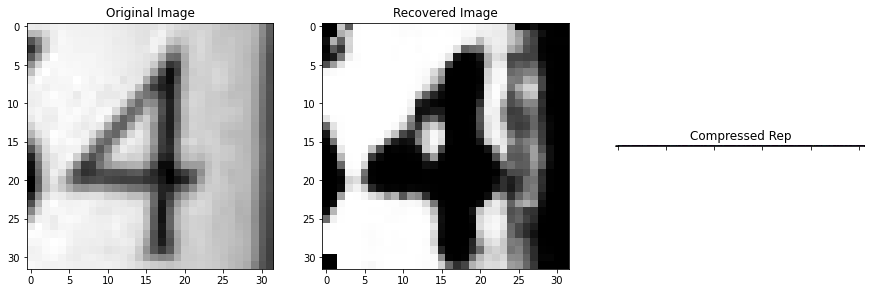

MSE tensor(0.1031, grad_fn=<SqueezeBackward0>)


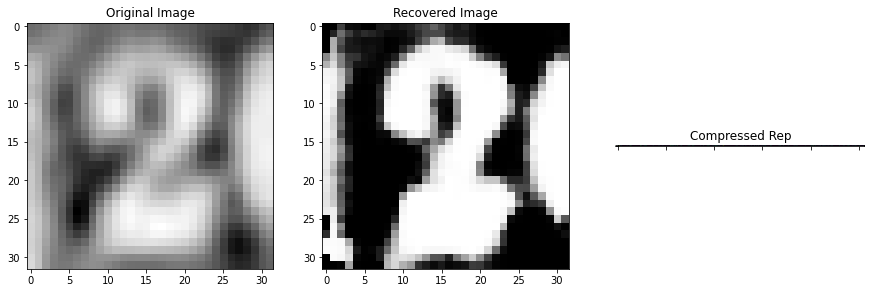

MSE tensor(0.0954, grad_fn=<SqueezeBackward0>)


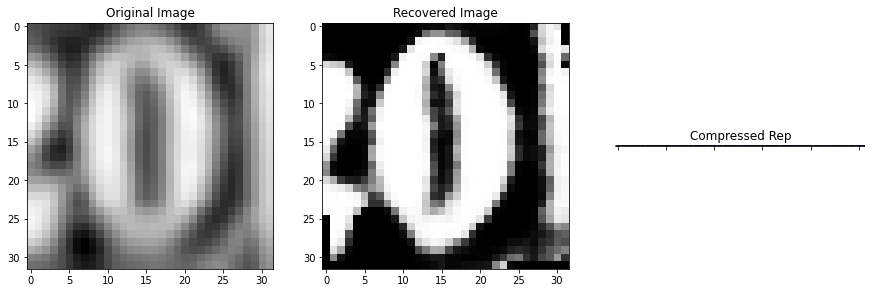

MSE tensor(0.0988, grad_fn=<SqueezeBackward0>)


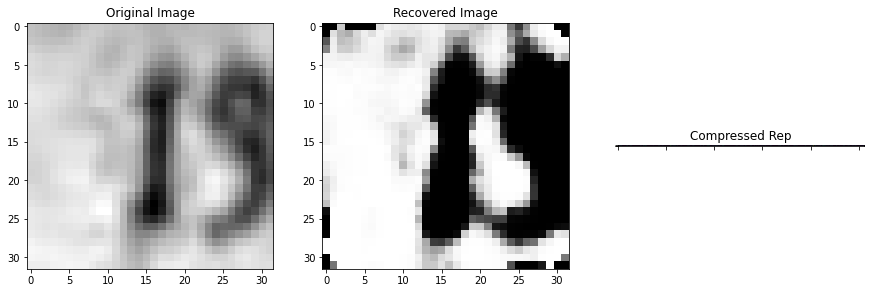

MSE tensor(0.1528, grad_fn=<SqueezeBackward0>)


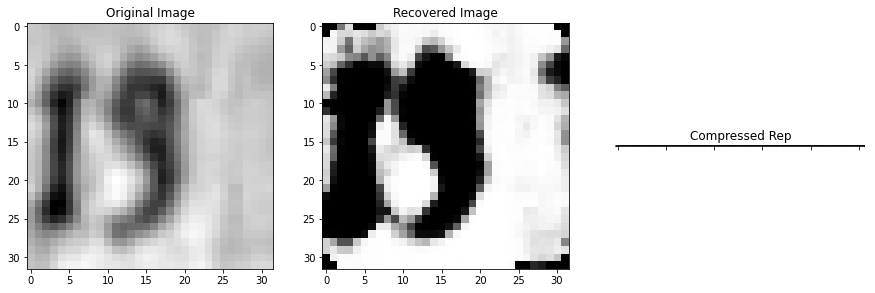

MSE tensor(0.1595, grad_fn=<SqueezeBackward0>)


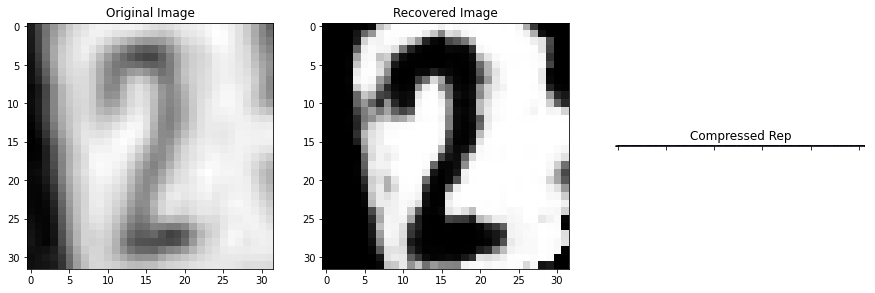

MSE tensor(0.0893, grad_fn=<SqueezeBackward0>)


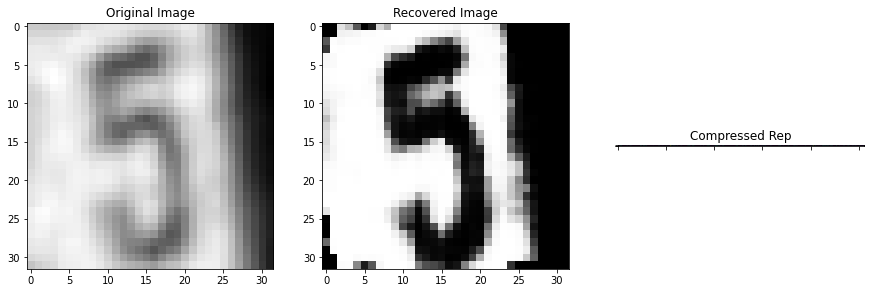

MSE tensor(0.0863, grad_fn=<SqueezeBackward0>)


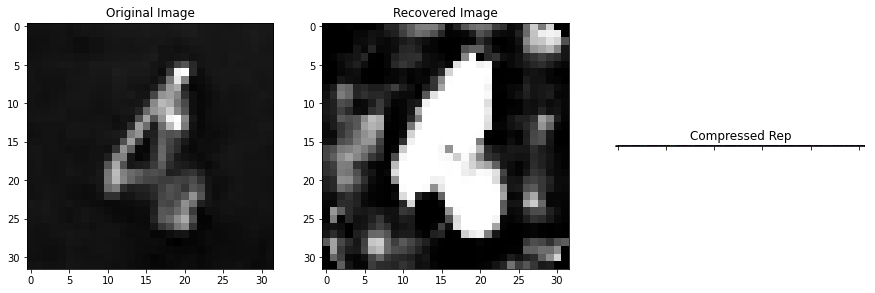

MSE tensor(0.1053, grad_fn=<SqueezeBackward0>)


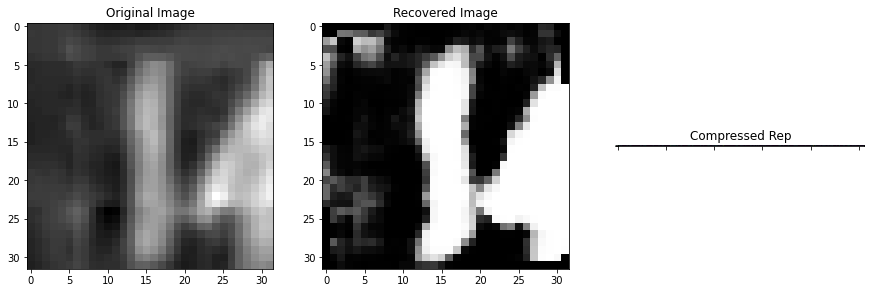

MSE tensor(0.1326, grad_fn=<SqueezeBackward0>)


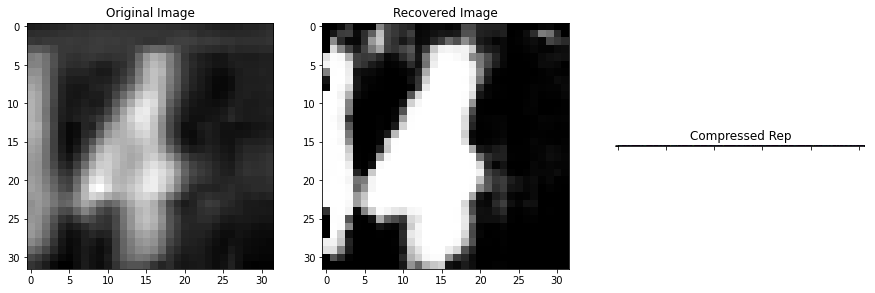

MSE tensor(0.1375, grad_fn=<SqueezeBackward0>)


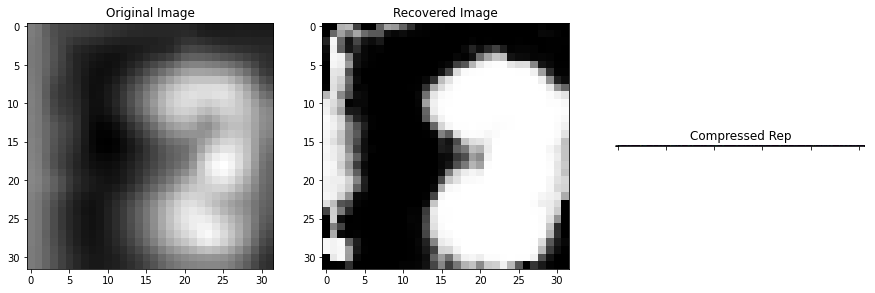

MSE tensor(0.1115, grad_fn=<SqueezeBackward0>)


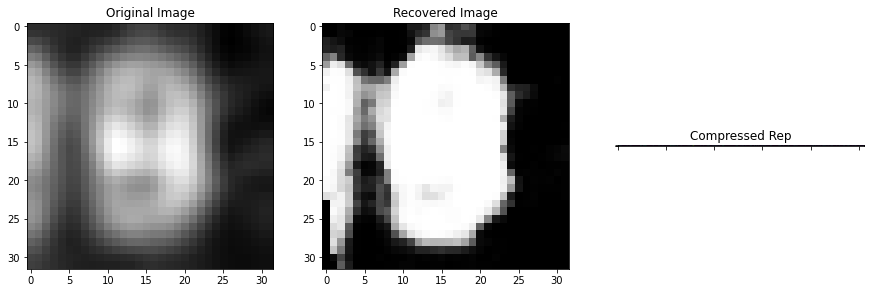

MSE tensor(0.0956, grad_fn=<SqueezeBackward0>)


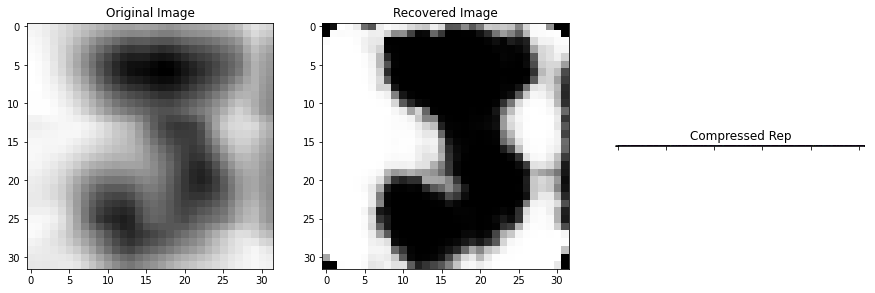

MSE tensor(0.1558, grad_fn=<SqueezeBackward0>)


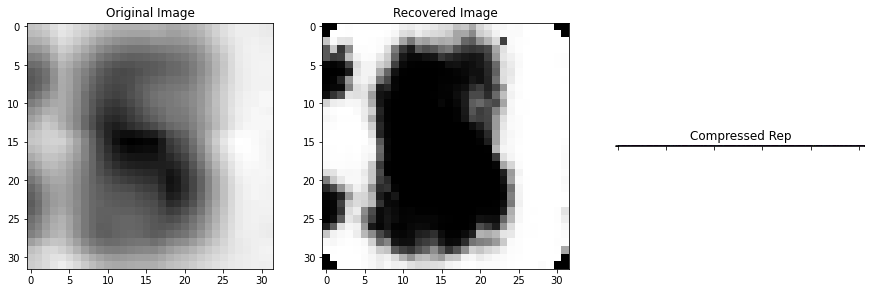

MSE tensor(0.1534, grad_fn=<SqueezeBackward0>)


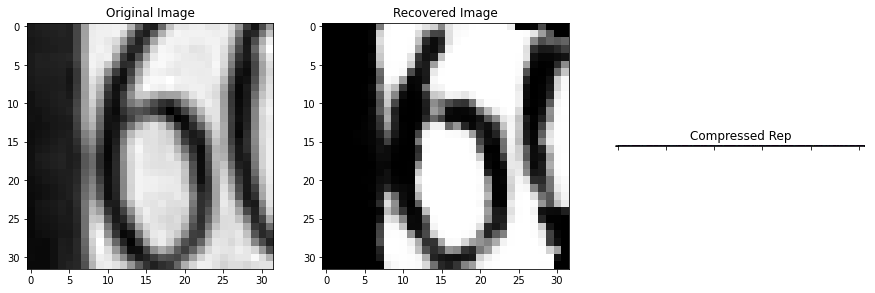

MSE tensor(0.1053, grad_fn=<SqueezeBackward0>)


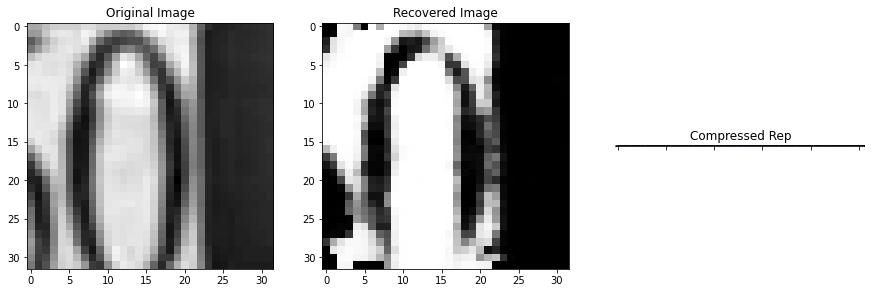

MSE tensor(0.1108, grad_fn=<SqueezeBackward0>)


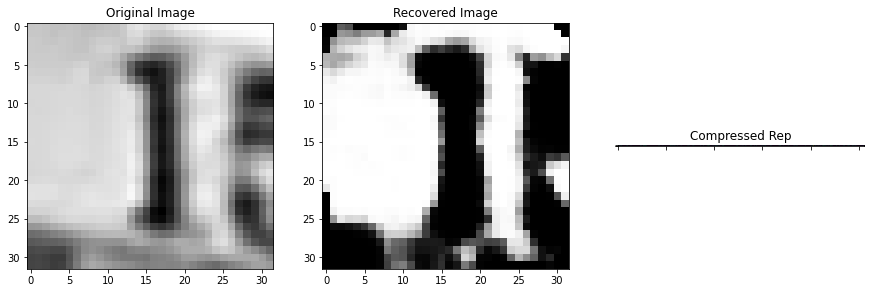

MSE tensor(0.1131, grad_fn=<SqueezeBackward0>)


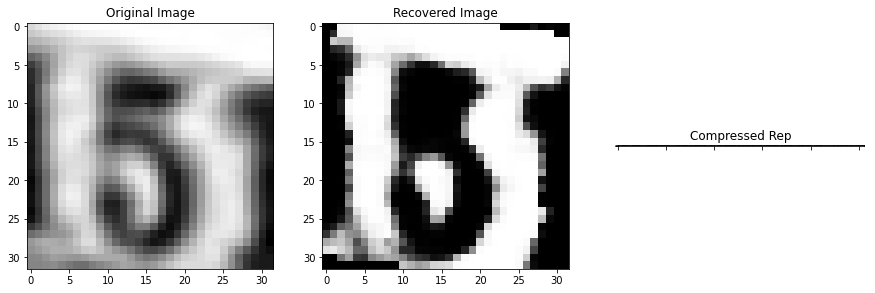

MSE tensor(0.0935, grad_fn=<SqueezeBackward0>)


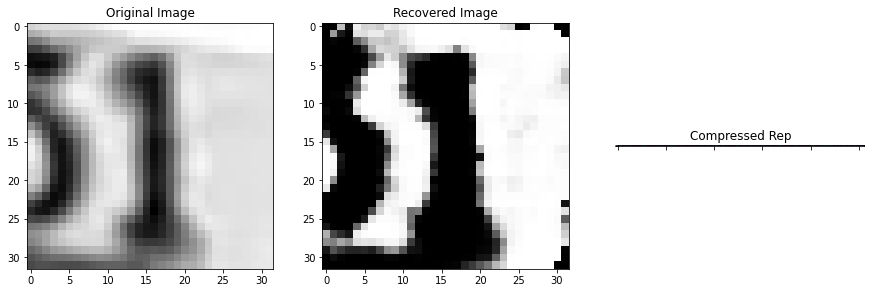

MSE tensor(0.1027, grad_fn=<SqueezeBackward0>)


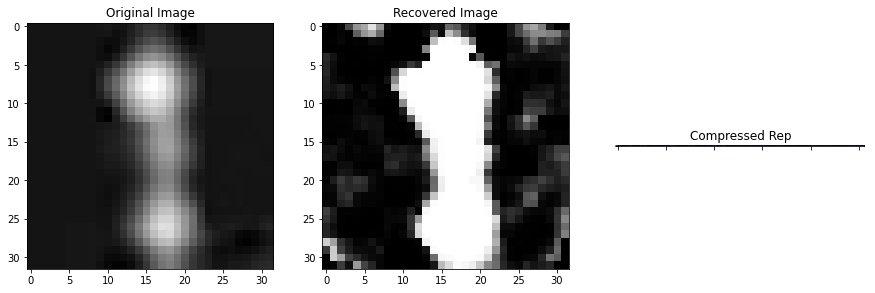

MSE tensor(0.1661, grad_fn=<SqueezeBackward0>)


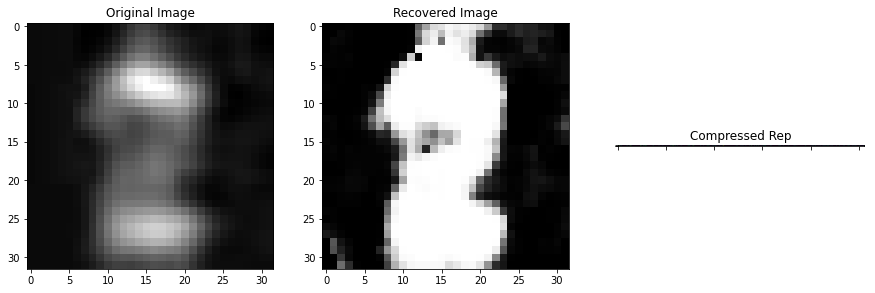

MSE tensor(0.1689, grad_fn=<SqueezeBackward0>)


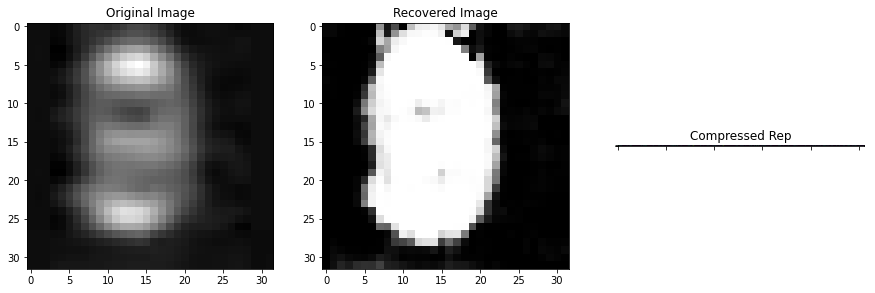

MSE tensor(0.1694, grad_fn=<SqueezeBackward0>)


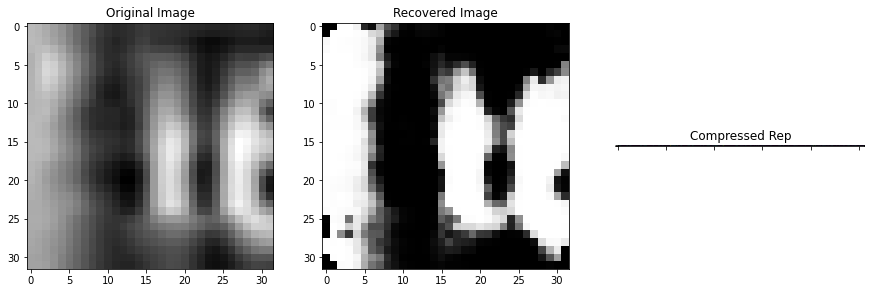

MSE tensor(0.1807, grad_fn=<SqueezeBackward0>)


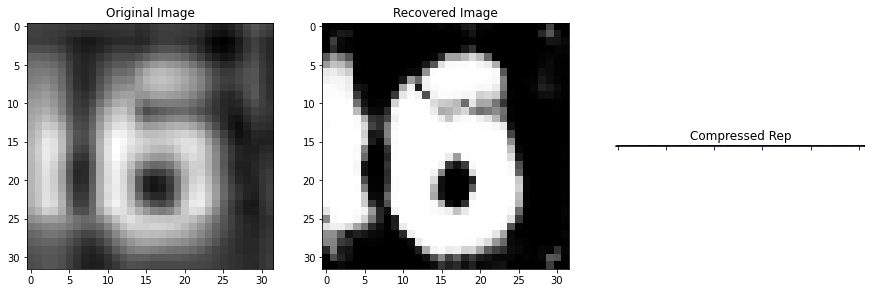

MSE tensor(0.1726, grad_fn=<SqueezeBackward0>)


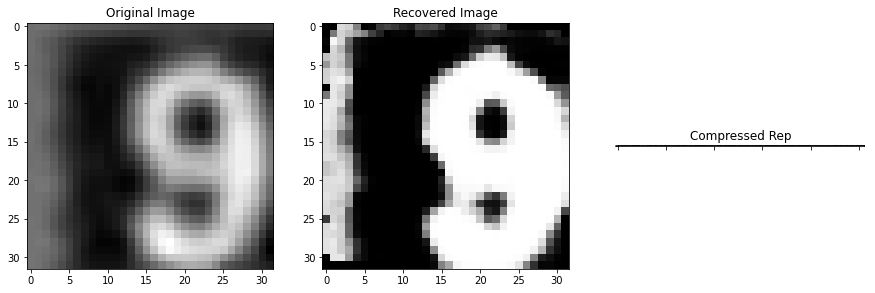

MSE tensor(0.0797, grad_fn=<SqueezeBackward0>)


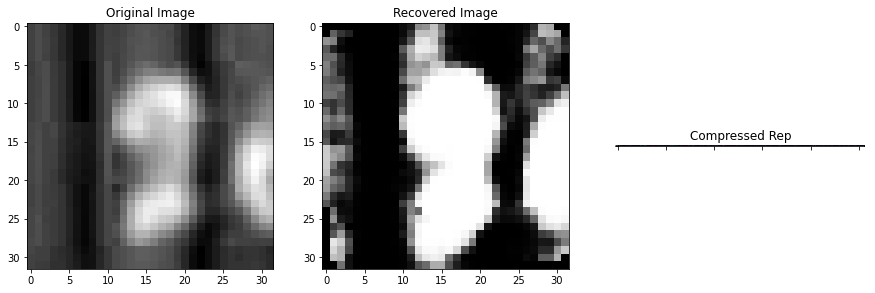

MSE tensor(0.1409, grad_fn=<SqueezeBackward0>)


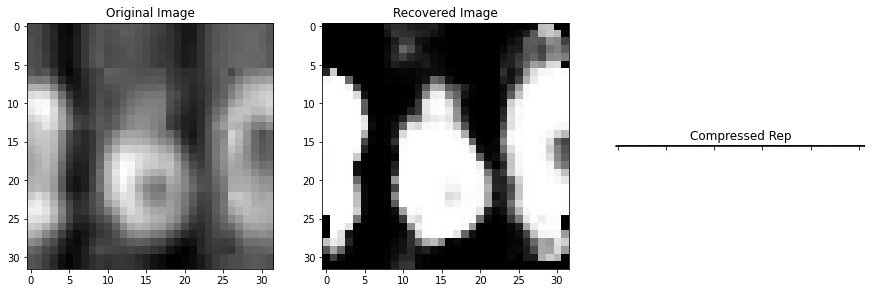

MSE tensor(0.1628, grad_fn=<SqueezeBackward0>)


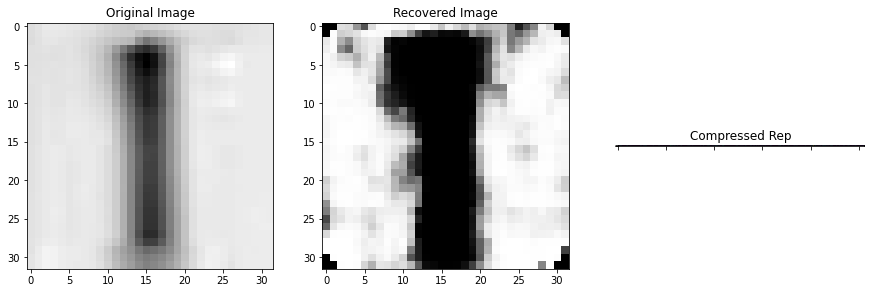

MSE tensor(0.1103, grad_fn=<SqueezeBackward0>)


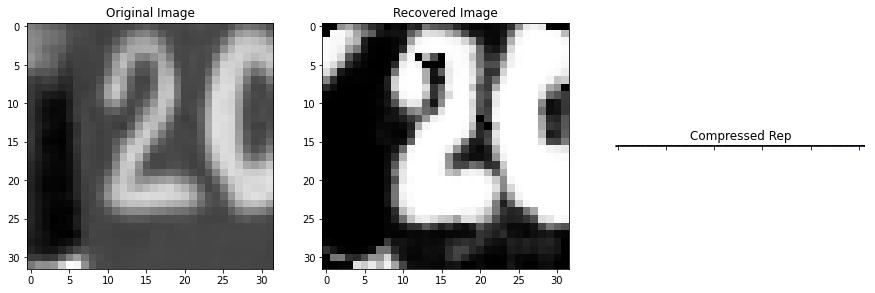

MSE tensor(0.0977, grad_fn=<SqueezeBackward0>)


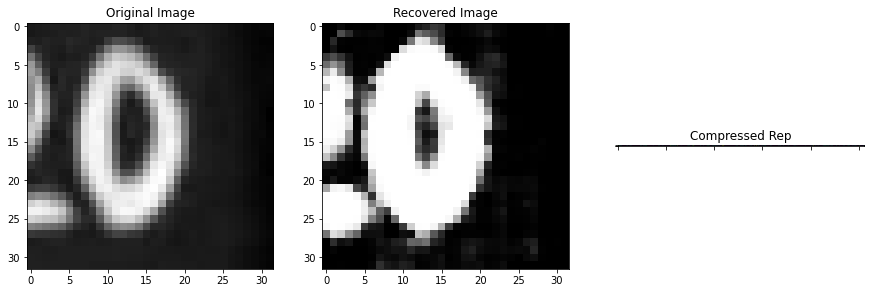

MSE tensor(0.0898, grad_fn=<SqueezeBackward0>)


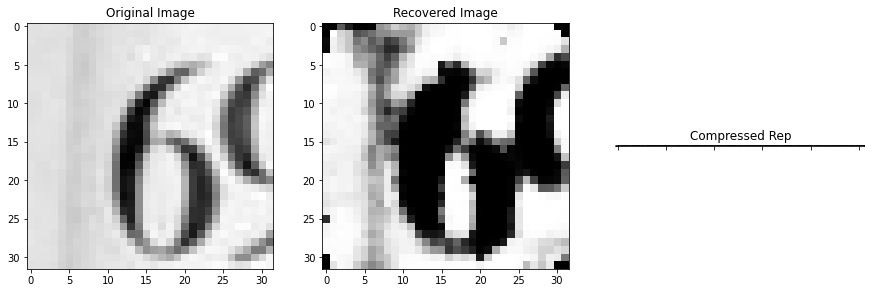

MSE tensor(0.1327, grad_fn=<SqueezeBackward0>)


In [ ]:
# Get model image reconstructions

model.eval()

for img_idx in range(len(test_data_ex3)):
    img = test_data_ex3.__getitem__(img_idx)

    fig = plt.figure(figsize=(15, 5))
    plt.subplot(1, 3, 1)
    plt.imshow(np.squeeze(img.numpy(), axis=0), cmap='gray')
    plt.title('Original Image')

    plt.subplot(1, 3, 2)
    recomposed_img, compress_rep = model.forward(img.unsqueeze(0))
    plt.imshow(recomposed_img.detach().numpy().squeeze(0).squeeze(0), cmap='gray')
    plt.title('Recovered Image')

    plt.subplot(1, 3, 3)
    plt.imshow(compress_rep.detach().numpy())
    plt.title('Compressed Rep')
    plt.xticks(color='w')
    plt.yticks(color='w')

    plt.show()

    mse = torchmetrics.MeanSquaredError()
    print('MSE', mse(recomposed_img.squeeze(0), img))

<font color='red'>COMMENTS</font> 

We can see in the autoencoder reconstructed test images from the original images how the results are really good. The numbers are more emphasized and the image, in general, is more binarized, with sharpened edges. 

In [ ]:
# Get image embeddings

model.eval()

train_data_ex3.transforms = transforms.Compose([
                                    transforms.ToTensor(), 
                                    transforms.Grayscale(1)
                            ])

unlabelled_embeddings = []
for img_idx in tqdm(range(len(train_data_ex3))):
    img = train_data_ex3.__getitem__(img_idx)
    _, img_embedding = model.forward(img.unsqueeze(0))
    unlabelled_embeddings.append(img_embedding.flatten().detach().numpy())

unlabelled_embeddings = np.array(unlabelled_embeddings)
unlabelled_embeddings.shape

100%|██████████| 73257/73257 [17:59<00:00, 67.83it/s]


(73257, 256)

In [ ]:
# Nearest Neighbors model to find similar embeddings
knn = NearestNeighbors(n_neighbors=5, metric="cosine")
knn.fit(unlabelled_embeddings)

NearestNeighbors(metric='cosine')

Accuracy for test sample 0 with label 5  in TOP5 retrieved images: 0.4


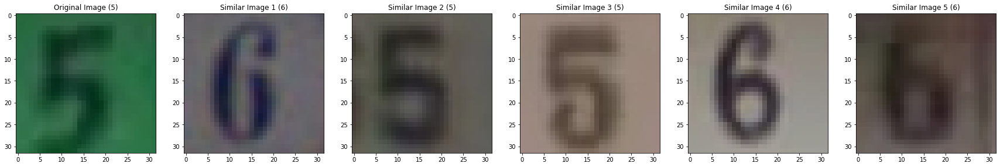

Accuracy for test sample 1 with label 2  in TOP5 retrieved images: 0.8


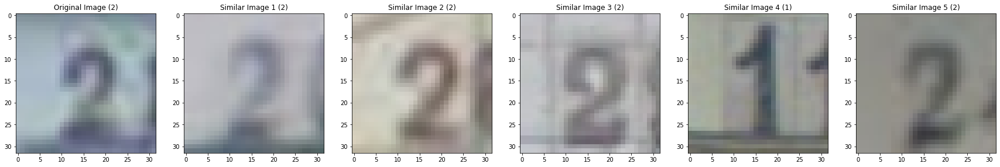

Accuracy for test sample 2 with label 1  in TOP5 retrieved images: 0.6


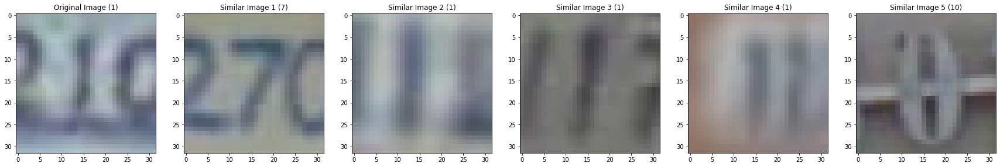

Accuracy for test sample 3 with label 10  in TOP5 retrieved images: 0.6


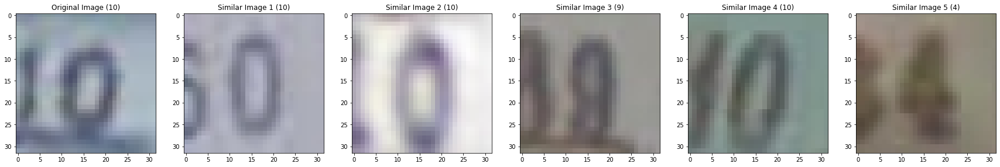

Accuracy for test sample 4 with label 6  in TOP5 retrieved images: 1.0


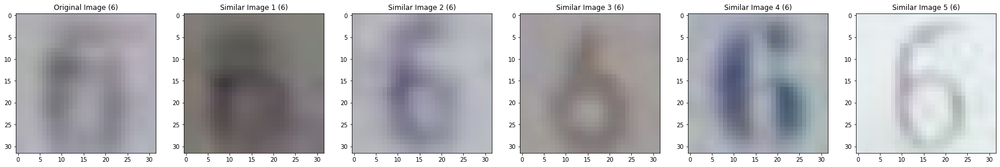

Accuracy for test sample 5 with label 1  in TOP5 retrieved images: 0.8


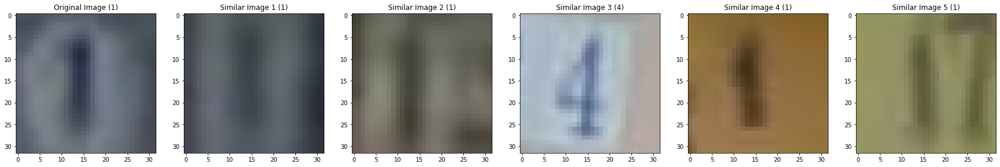

Accuracy for test sample 6 with label 9  in TOP5 retrieved images: 0.6


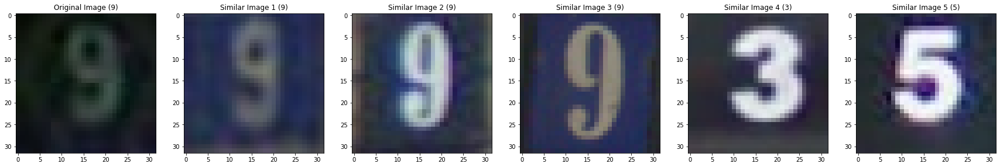

Accuracy for test sample 7 with label 1  in TOP5 retrieved images: 1.0


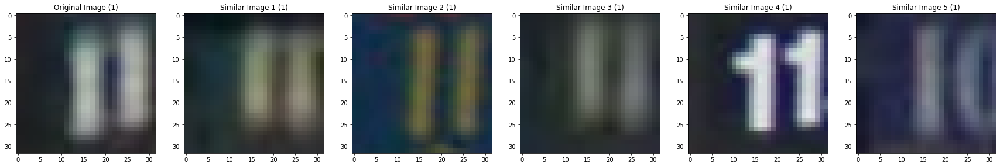

Accuracy for test sample 8 with label 1  in TOP5 retrieved images: 1.0


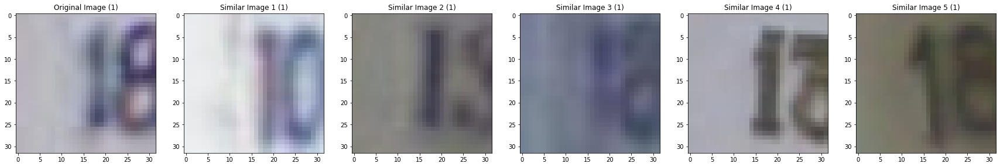

Accuracy for test sample 9 with label 8  in TOP5 retrieved images: 0.2


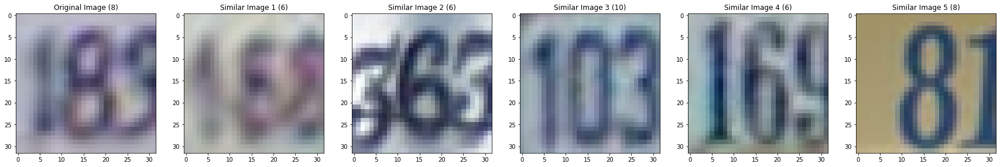

Accuracy for test sample 10 with label 3  in TOP5 retrieved images: 0.2


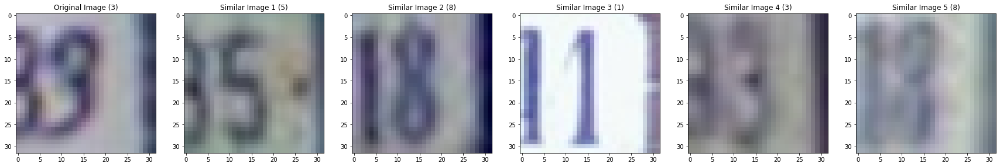

Accuracy for test sample 11 with label 6  in TOP5 retrieved images: 0.6


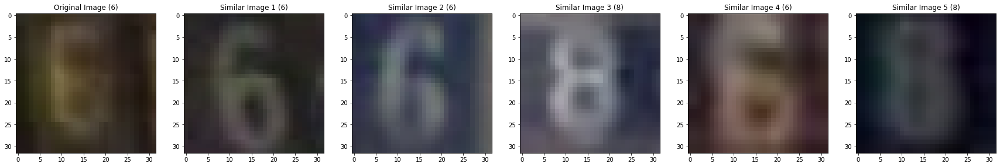

Accuracy for test sample 12 with label 5  in TOP5 retrieved images: 0.6


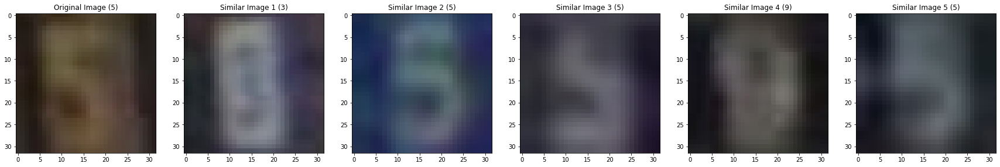

Accuracy for test sample 13 with label 1  in TOP5 retrieved images: 0.6


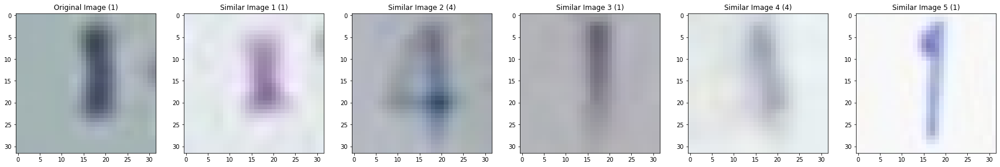

Accuracy for test sample 14 with label 4  in TOP5 retrieved images: 0.6


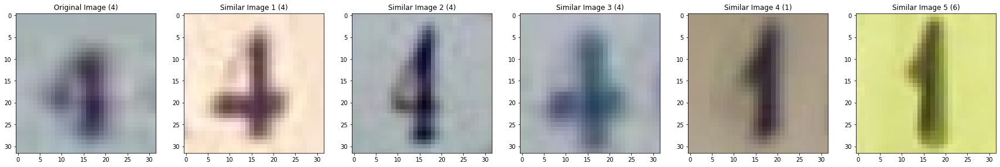

Accuracy for test sample 15 with label 4  in TOP5 retrieved images: 0.6


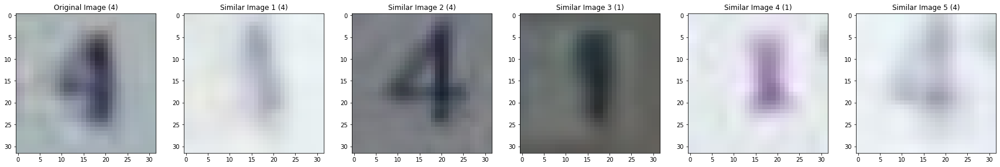

Accuracy for test sample 16 with label 1  in TOP5 retrieved images: 1.0


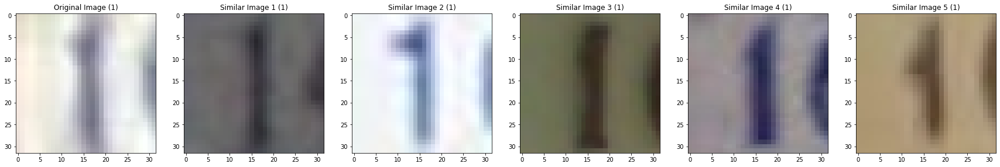

Accuracy for test sample 17 with label 6  in TOP5 retrieved images: 0.8


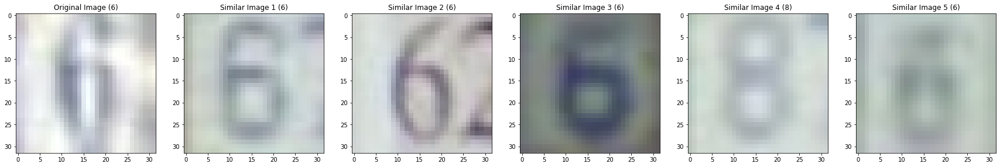

Accuracy for test sample 18 with label 3  in TOP5 retrieved images: 0.8


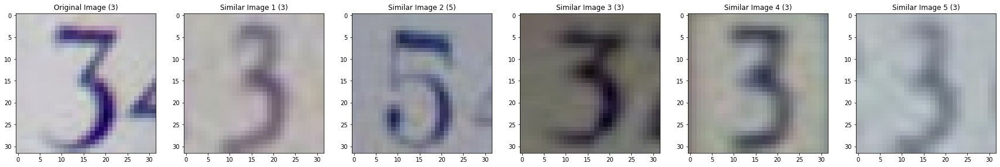

Accuracy for test sample 19 with label 4  in TOP5 retrieved images: 1.0


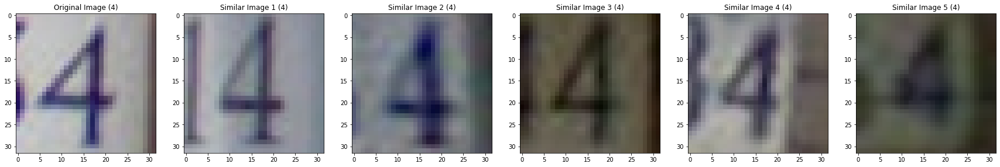

Accuracy for test sample 20 with label 2  in TOP5 retrieved images: 1.0


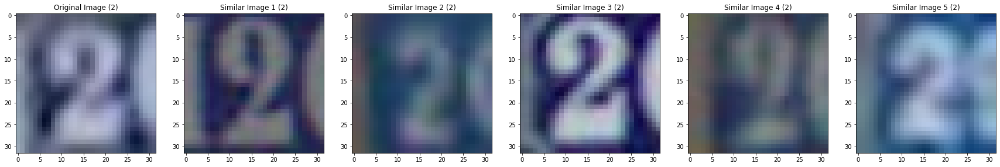

Accuracy for test sample 21 with label 10  in TOP5 retrieved images: 1.0


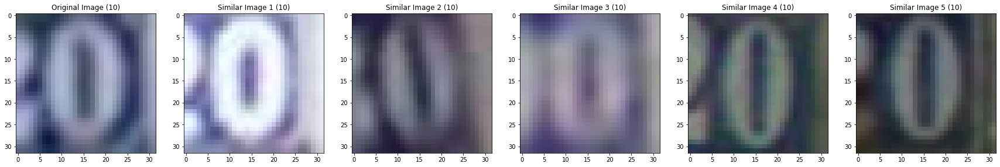

Accuracy for test sample 22 with label 1  in TOP5 retrieved images: 1.0


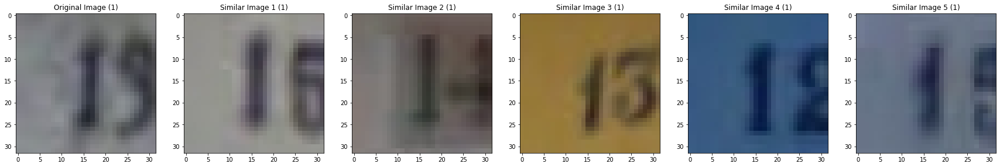

Accuracy for test sample 23 with label 3  in TOP5 retrieved images: 0.2


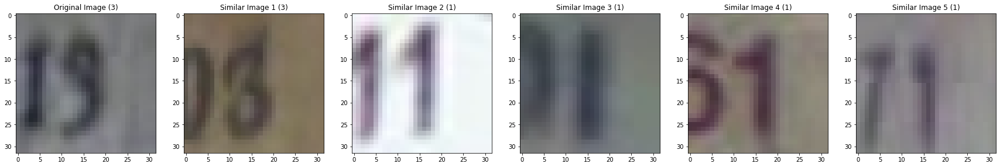

Accuracy for test sample 24 with label 2  in TOP5 retrieved images: 0.6


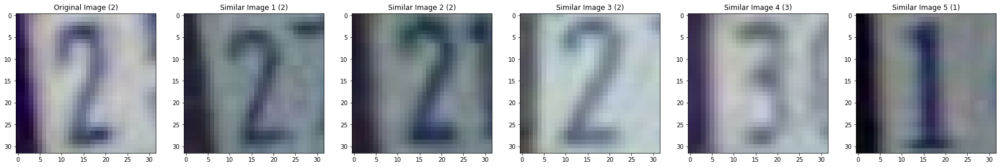

Accuracy for test sample 25 with label 5  in TOP5 retrieved images: 0.4


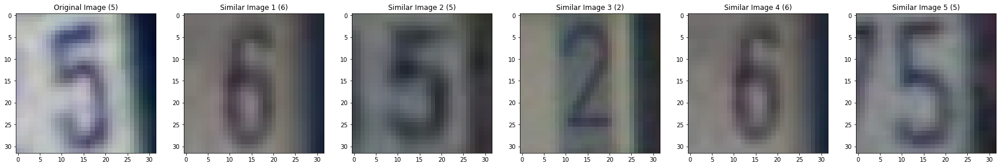

Accuracy for test sample 26 with label 4  in TOP5 retrieved images: 1.0


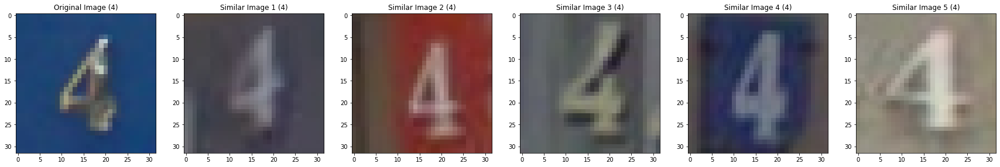

Accuracy for test sample 27 with label 1  in TOP5 retrieved images: 1.0


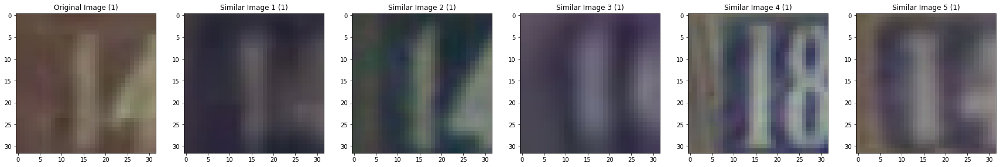

Accuracy for test sample 28 with label 4  in TOP5 retrieved images: 1.0


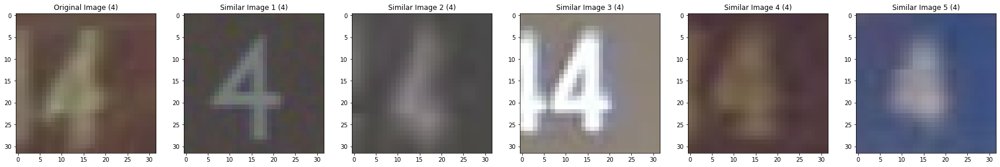

Accuracy for test sample 29 with label 2  in TOP5 retrieved images: 0.0


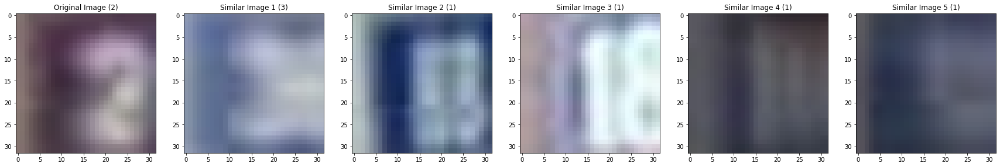

Accuracy for test sample 30 with label 8  in TOP5 retrieved images: 0.0


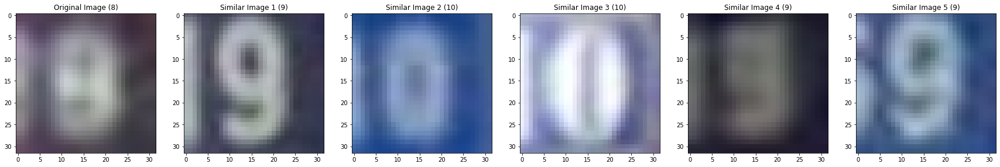

Accuracy for test sample 31 with label 3  in TOP5 retrieved images: 1.0


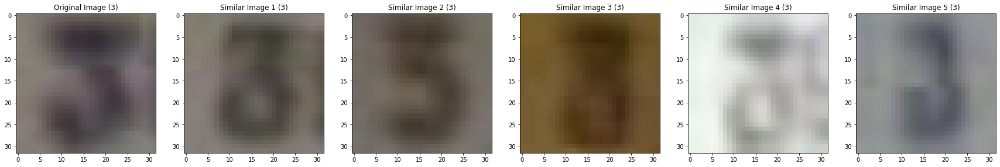

Accuracy for test sample 32 with label 8  in TOP5 retrieved images: 0.4


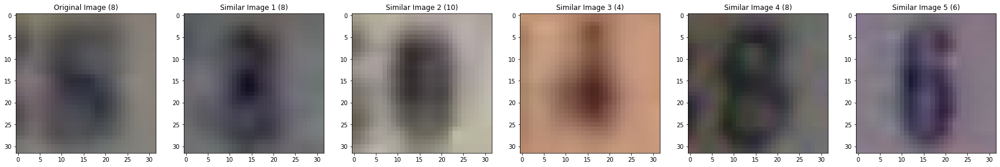

Accuracy for test sample 33 with label 6  in TOP5 retrieved images: 0.6


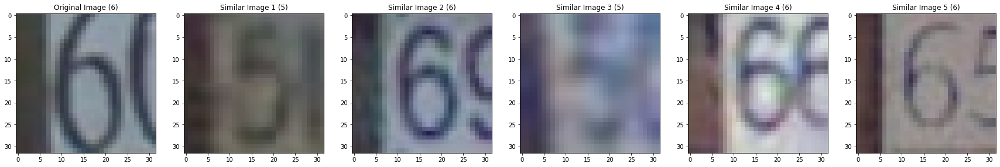

Accuracy for test sample 34 with label 10  in TOP5 retrieved images: 0.2


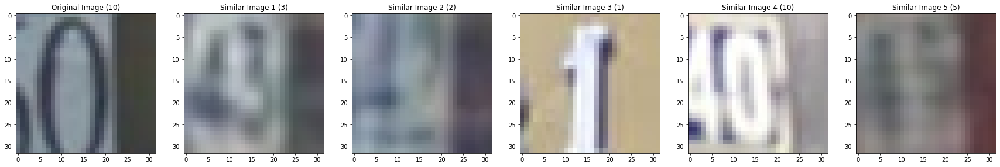

Accuracy for test sample 35 with label 1  in TOP5 retrieved images: 1.0


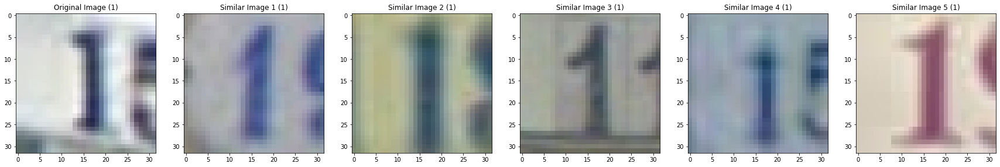

Accuracy for test sample 36 with label 5  in TOP5 retrieved images: 0.4


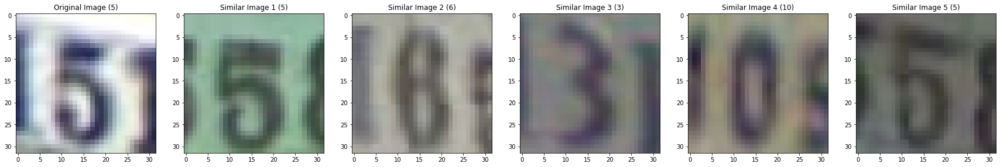

Accuracy for test sample 37 with label 1  in TOP5 retrieved images: 0.6


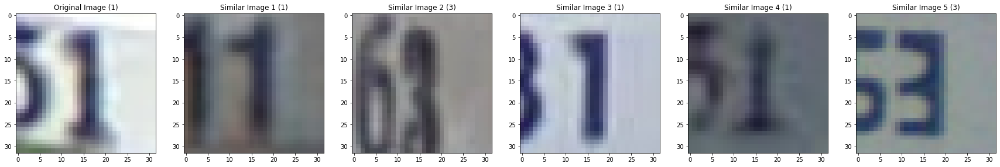

Accuracy for test sample 38 with label 1  in TOP5 retrieved images: 1.0


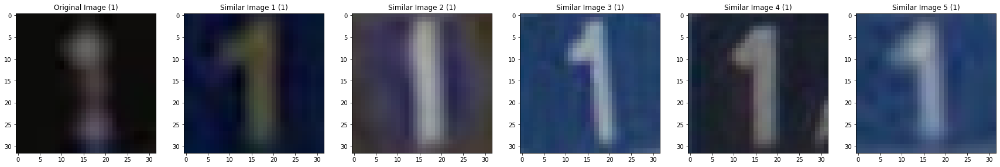

Accuracy for test sample 39 with label 2  in TOP5 retrieved images: 0.8


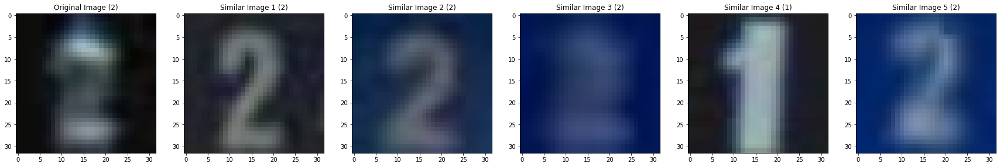

Accuracy for test sample 40 with label 9  in TOP5 retrieved images: 0.2


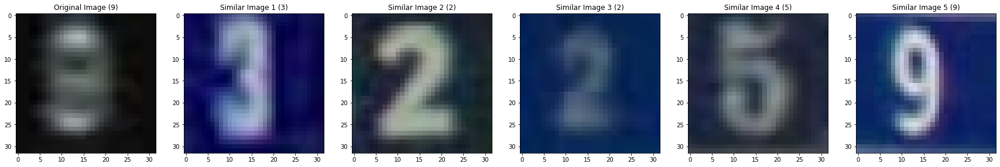

Accuracy for test sample 41 with label 1  in TOP5 retrieved images: 1.0


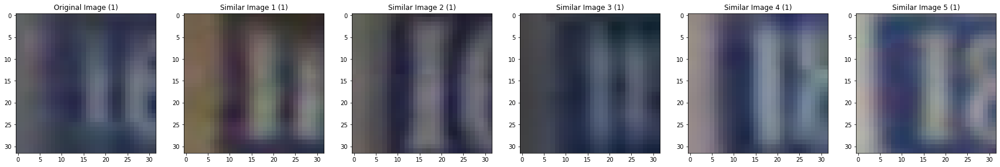

Accuracy for test sample 42 with label 6  in TOP5 retrieved images: 0.6


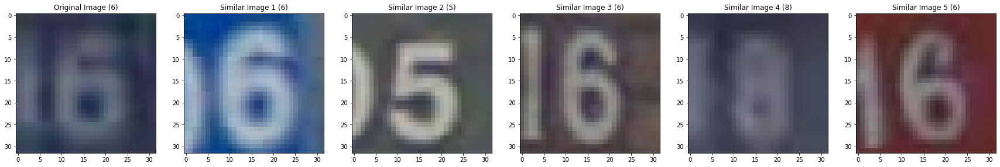

Accuracy for test sample 43 with label 9  in TOP5 retrieved images: 0.0


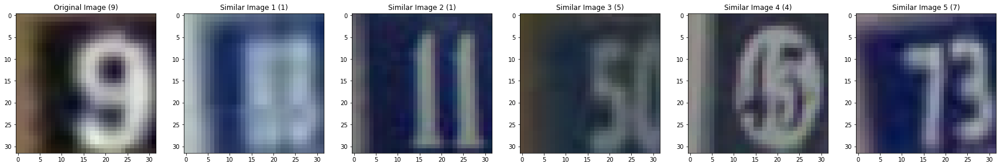

Accuracy for test sample 44 with label 2  in TOP5 retrieved images: 0.2


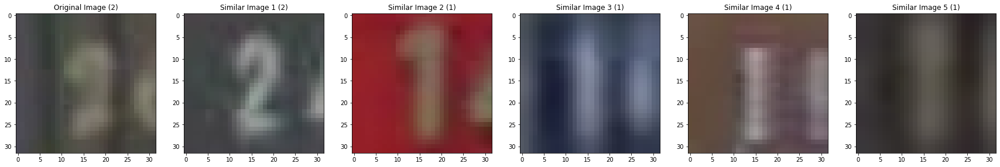

Accuracy for test sample 45 with label 6  in TOP5 retrieved images: 0.2


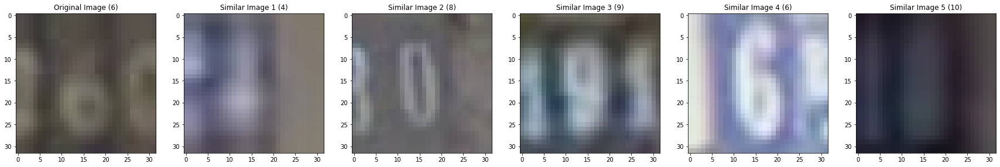

Accuracy for test sample 46 with label 1  in TOP5 retrieved images: 1.0


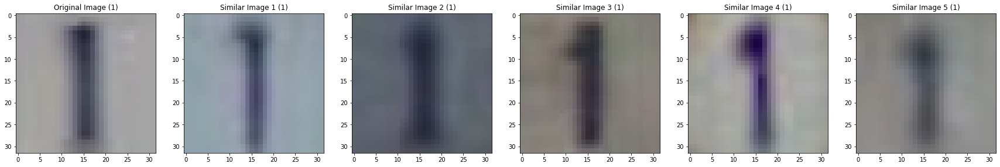

Accuracy for test sample 47 with label 2  in TOP5 retrieved images: 0.2


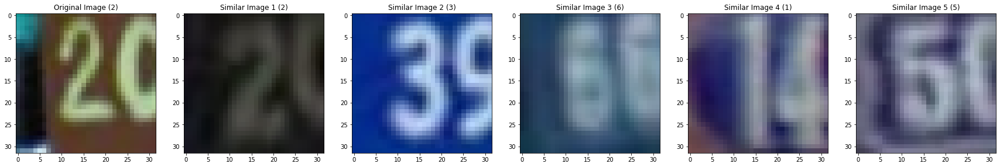

Accuracy for test sample 48 with label 10  in TOP5 retrieved images: 0.4


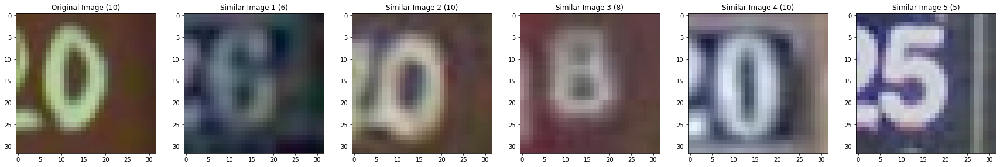

Accuracy for test sample 49 with label 6  in TOP5 retrieved images: 0.8


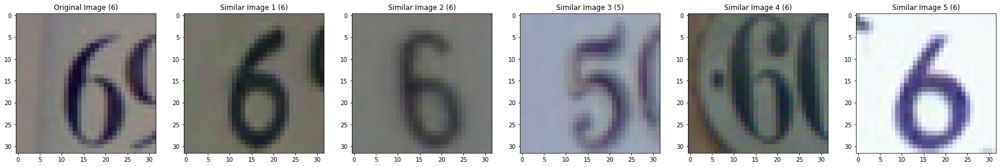

Average Accuracy over the testing set: 0.632


In [ ]:
model.eval()

img_accuracies = [] 
K = 5
for img_idx in range(len(test_data_ex3)):
    img = test_data_ex3.__getitem__(img_idx)
    # Get embedding
    _, img_embedding = model.forward(img.unsqueeze(0))
    # Find nearest embeddings from train set
    idx = knn.kneighbors([img_embedding.flatten().detach().numpy()], K, return_distance=False)[0]
    similar_img_labels = train_data_ex3.labels[idx]
    img_label = test_data_ex3.labels[img_idx]
    # Compute accuracy
    image_accuracy = (similar_img_labels==img_label).mean()
    # print(similar_img_labels, img_label, (similar_img_labels==img_label), image_accuracy)
    img_accuracies.append(image_accuracy)
    print('Accuracy for test sample {idx} with label {label}  in TOP{K} retrieved images: {acc}'.format(idx=img_idx,
                                                                                                        label= img_label,
                                                                                                        K=K,
                                                                                                        acc = image_accuracy))
    
    # Plot query image and retrieve similar images
    fig = plt.figure(figsize=(30, 10))
    plt.subplot(1, 6, 1)
    plt.imshow(test_imgs[:, :, :, img_idx])
    plt.title(f'Original Image ({test_labels[img_idx]})')

    for i, imgid in enumerate(idx):
        plt.subplot(1, 6, 2 + i)
        plt.imshow(unlabelled_imgs[:, :, :, imgid])
        plt.title(f'Similar Image {i + 1} ({unlabelled_labels[imgid]})')

    plt.show()

# Compute average accuracy over testing set    
average_acc = np.asarray(img_accuracies).mean()
print('Average Accuracy over the testing set: {acc}'.format(acc=average_acc))

<font color='red'>COMMENTS</font> 

The proposal has increased the average accuracy by approximately 29% (up to 63.2%). The accuracy strongly depends of the embedding generated by the convolutional autoencoder, and specially, of the embedding generated from the query image, and some of them are really challenging even for humans.

In order to achieve a good embedding, the number of parameters of the convolutional autoencoder has been greatly increased (since task 3 has no parameter constraints). However, the average accuracy has not increased that much. Due to Google Colab's GPU usage time limits, I have not been able to test another approach that might increase accuracy, like using some pre-train models (i.e. ResNet of VGG) and removing the last few layers to take the feature extractor part and using it as embedding.

I've tested also more classical computer vision methods like extracting descriptors from the image (with SIFT), but the results were not better.
